# TASK 6 + 8 - Grafici - :

## Task-6_Regressioni:
per ogni Dataset: ['b990', 'b025', 'b050', 'b065', 'b080', 'b100', 'pi-Control', 'hist', 'obs'] è stato eseguito:
   - Calcolo e graficazione delle Regressioni dei seguenti campi sui rispettivi indici Nino3.4 derivati dallo script 'Task-5':
      - tos --> sst
      - tas --> t2m
      - ua --> ua850 + ua200
      - pr --> prec
      - zg --> zg500
      -Nota:
         -Le regressioni ad eccezione dei Dataset Storico e Osservato sono state limitate agli ultimi 100 anni, per motivi computazionali.

## Task-8_Composites:
per ogni Dataset: ['b990', 'b025', 'b050', 'b065', 'b080', 'b100', 'pi-Control', 'hist', 'obs'] è stato eseguito:
   - Calcolo delle Composite di: Nino + Nina; Nino; Nino: dataset - Pi-conttrol; Nina; dei seguenti campi:
      - tos --> sst
      - tas --> t2m
      - ua --> ua850 + ua200
      - pr --> prec
      -Nota:
         -per il campo di zg non è stato possibile tale calcolo per il modo in cui esso è stato calcolato all'inizio: cioè come media dei mesi 'DJF' per ogni anno
         -le composite per il campo di 'thetao' sono nel file Task-7_Thermocline.  

In [1]:
### import libraries ###

# General data analisys libraries 
import numpy as np
import xarray as xr
import cftime
import pickle
# Plot libraries
import matplotlib as mpl
import matplotlib.pyplot as plt
import cartopy as cart
import cartopy.crs as ccrs
import cartopy.util as cutil
import cartopy.feature as cfeature
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

In [2]:
#Comando che rende le immagini generate visualizzabili
%matplotlib inline

In [3]:
""" I dataset in 'datasets_names' non sono omogenei, il 'pi-control'; 'hist' e 'obs' sono più corti degli altri,
perciò è necessario calcolarlo ma soprattutto stoccarlo in variabili separate,
altrimenti si avranno sempre errori. Poi verrà aggiunto ai grafici separatamente. """

" I dataset in 'datasets_names' non sono omogenei, il 'pi-control'; 'hist' e 'obs' sono più corti degli altri,\nperciò è necessario calcolarlo ma soprattutto stoccarlo in variabili separate,\naltrimenti si avranno sempre errori. Poi verrà aggiunto ai grafici separatamente. "

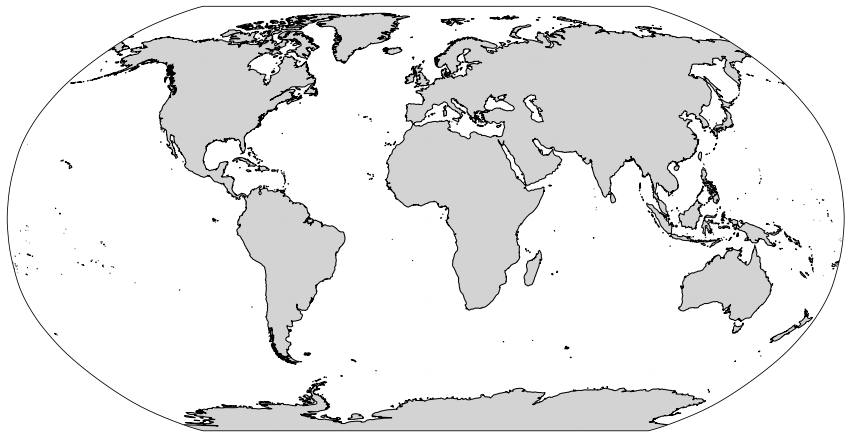

In [9]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

plt.figure(figsize=(15, 10))
ax = plt.axes(projection=ccrs.Robinson())
res = '50m'
# Nascondi la linea esterna di demarcazione dell'elissoide terrestre
#ax.outline_patch.set_visible(False)
ax.add_feature(cfeature.LAND.with_scale(res), facecolor='lightgray')
ax.coastlines(resolution='50m')
ax.gridlines(linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
plt.savefig('/home/montanarini/images/copertina1.pdf', bbox_inches='tight')
plt.savefig('/home/montanarini/images/copertina1.png', bbox_inches='tight', dpi=150)
plt.show()

/tmp/ipykernel_17296/3784212531.py:5: DeprecationWarning: The outline_patch property is deprecated. Use GeoAxes.spines['geo'] or the default Axes properties instead.
  ax.outline_patch.set_visible(False)


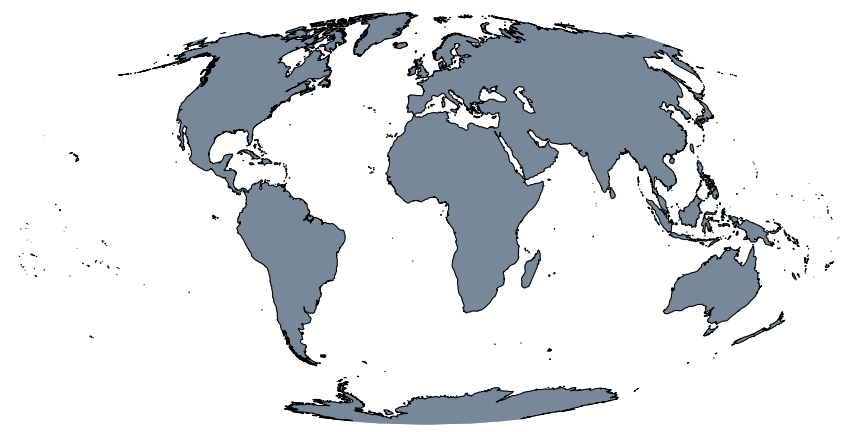

In [4]:
plt.figure(figsize=(15, 10))
ax = plt.axes(projection=ccrs.Mollweide())
res = '50m'
# Nascondi la linea esterna di demarcazione dell'elissoide terrestre
ax.outline_patch.set_visible(False)
ax.add_feature(cfeature.LAND.with_scale(res), facecolor='lightslategray')
ax.coastlines(resolution=res)
ax.gridlines(linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
plt.savefig('/home/montanarini/images/copertina00.pdf', bbox_inches='tight')
plt.savefig('/home/montanarini/images/copertina00.png', bbox_inches='tight', dpi=150)
plt.show()

In [3]:
""" Regressioni, Thermoclina e Composites """

# Directories
common_Dir_home = '/home/montanarini/'
dir_Output6 = 'output/Task-6/Variables/'
dir_Output7 = 'output/Task-7/Variables/old/'
dir_Output8 = 'output/Task-8/Variables/'
dir_Images6 = 'images/task6-Regressions/'
dir_Images7 = 'images/task7-Thermocline/'
dir_Images8 = 'images/task8-Composites/'

# Lists
dataset_names = ['b990','b025', 'b050', 'b065', 'b080', 'b100', 'pi-control', 'hist', 'obs']
dataset_names_excluded = ['obs']
dataset_names_num = len(dataset_names)
var_names = ['tos', 'thetao', 'tas', 'ua', 'pr', 'zg'] # Variaibili dei datsaset
var_names_sel = ['tos', 'tas', 'ua850', 'ua200', 'pr', 'zg'] # Variaibili che io vado a nominare ed utilizzre: 'thetao' viene aggiunto alla riga 57, dopo la creazione del dizionario
regression_products = ['trend', 'intercept', 'trend_err', 'intercept_err', 'pval'] # Nomi dei prodotti generati dalla funzione che calcola la regressione

# Plots formatting string lists
colors = ['blue', 'green', 'orange', 'red', 'brown', 'purple', 'darkgray', 'olive', 'pink']


# Hist's Dataset Recovering 
Dir_hist_tos = '/nas/BOTTINO/CMIP6/LongRunMIP/EC-Earth-Consortium/EC-Earth3/historical/r4i1p1f1/Omon_r25/tos/*.nc' # Modello storico #'/nas/BOTTINO/CMIP6/LongRunMIP/EC-Earth-Consortium/EC-Earth3/historical/r4i1p1f1/Omon/tos_rg_1850-2014.nc'
Dataset_hist_tos = xr.open_mfdataset(Dir_hist_tos)
Dataset_hist_tos = Dataset_hist_tos.sel(lat=slice(-85, 85)).compute() # lat=slice(-5, 5), lon=slice(190, 240)
hist_tos = Dataset_hist_tos['tos']
# tas --> T2m
# Dir_hist_tas = '/nas/BOTTINO/CMIP6/LongRunMIP/EC-Earth-Consortium/EC-Earth3/historical/r4i1p1f1/Amon/tas/*.nc'
# Dataset_hist_tas = xr.open_mfdataset(Dir_hist_tas)
# Dataset_hist_tas = Dataset_hist_tas.sel(lat=slice(-5, 5), lon=slice(190, 240)).compute()
# hist_tas = Dataset_hist_tos['tas']


### Coordinates aquisition ###

# Getting the Coordinates
latO = hist_tos['lat'] # Ocean's Latitude 
lonO = hist_tos['lon'] # Ocean's Longitude
lon_o = lonO.copy() # For not overwrite the lonO var in the hiding of the the white longitude line

# latA = hist_tas['lat'] # Atmosphere's Latitude 
# lonA = hist_tas['lon'] # Atmosphere's Longitude 

# Maschera continentale
continental_mask=np.isnan(hist_tos)[0,...]


# Regressions variables Dictionary  declaration
variables_dict = {}  # Dizionario per raccogliere i risultati delle elaborazioni dei dataset
for product in regression_products:
    variables_dict[product] = {}
    for var in var_names_sel:
        variables_dict[product][var] = {}
        for datasetN in dataset_names:
            variables_dict[product][var][datasetN] =  [[[[None]*len(lonO) for _ in range(len(latO))] for _ in dataset_names] for _ in var_names_sel]
termo = [None for _ in range(dataset_names_num-1)]
var_names_sel.insert(1, 'thetao') # lista su cui vado ad eseguire il main loop
print(var_names_sel)
# Composite dictionary declaration
composite_dict = {}
oscilaltion = ['nino', 'nina']
for phase in oscilaltion:
    composite_dict[phase] = {}
    for var in var_names_sel:
        composite_dict[phase][var] = {}
        if var == 'thetao':
            for datasetN in dataset_names:
                composite_dict[phase][var][datasetN] =  [[None]*len(lonO) for _ in range(63)] # 63 sonno i livelli di profondità del termoclino 
                                                                                             # (questa cosa può anche non essere specificata,
                                                                                             # lo faccio per fare il figo perchè così il compilatore
                                                                                             # sa già quanto spazio riservare alla variaibile da allocare)        else: # var != 'thetao': #var not in ['thetao']:
            for datasetN in dataset_names:
                composite_dict[phase][var][datasetN] =  [[None]*len(lonO) for _ in range(len(latO))]



#################################################################################################################################################
########################################################## Caricamento Variabili ################################################################
#################################################################################################################################################
print('Main loop, Start evaluating dataset products')

for i, var in enumerate(var_names_sel):
    
    for j, datasetN in enumerate(dataset_names):

        if var not in ['thetao']:
            
            if (var != 'tos' and datasetN == 'obs'): # skip each iteration for Dataset 'obs' except for 'tos'
                continue
            else:
                filename_reg = f'Task-6_{var}-Products-{datasetN}.p'
                data_recov_reg = pickle.load(open(common_Dir_home + dir_Output6 + filename_reg, 'rb'))
                filename_comp = f'Task-8_{var}-Composite-{datasetN}.p'
                data_recov_comp = pickle.load(open(common_Dir_home + dir_Output8 + filename_comp, 'rb'))

                for k, product in enumerate(regression_products):
                    variables_dict[product][var][datasetN] = data_recov_reg[k] # k deve andare da 0 a 4, cioè gli elementi in 'product'
                    if datasetN == 'obs':
                        variables_dict['trend'][var][datasetN] = xr.DataArray(variables_dict['trend'][var][datasetN], dims=['lat', 'lon'], coords={'lat':latO, 'lon':lonO})
                        variables_dict['trend'][var][datasetN] = xr.where(((np.abs(variables_dict['trend'][var][datasetN]) >  0.6) & 
                                                                            (variables_dict['trend'][var][datasetN]['lat'] > 50)) | 
                                                                            ((np.abs(variables_dict['trend'][var][datasetN]) >  0.3) & 
                                                                                (variables_dict['trend'][var][datasetN]['lat'] < -55)), 
                                                                                np.nan, variables_dict['trend'][var][datasetN])
                for phase in oscilaltion:
                    if phase == 'nino':
                        composite_dict[phase][var][datasetN] = data_recov_comp[0]
                    elif phase == 'nina':
                        composite_dict[phase][var][datasetN] = data_recov_comp[1]
                    
                    if datasetN == 'obs':
                        composite_dict[phase][var][datasetN] = xr.DataArray(composite_dict[phase][var][datasetN], dims=['lat', 'lon'], coords={'lat':latO, 'lon':lonO})
                        composite_dict[phase][var][datasetN] = xr.where(((np.abs(composite_dict[phase][var][datasetN]) >  0.6) & 
                                                                        (composite_dict[phase][var][datasetN]['lat'] > 50)) | 
                                                                        ((np.abs(composite_dict[phase][var][datasetN]) >  0.3) & 
                                                                            (composite_dict[phase][var][datasetN]['lat'] < -55)), 
                                                                            np.nan, composite_dict[phase][var][datasetN])

        else: #var == 'thetao':
            
            if datasetN != 'obs':
                filename = 'Task-7-{}.p'.format(datasetN)
                data_recov_thetao = pickle.load(open(common_Dir_home+dir_Output7+filename, 'rb'))
                termo[j] = data_recov_thetao[0]
                composite_dict['nino'][var][datasetN] = data_recov_thetao[1]
                composite_dict['nina'][var][datasetN] = data_recov_thetao[2]
        

    
        print(f'Dati del dataset {datasetN} caricati con successo')
    print(f'Dati del campo {var} caricati con successo')

# regression_product_dict['trend']['tos'][i]
#     0 = trend
#     1 = intercept
#     2 = trend_err
#     3 = intercept_err
#     4 = pval
#     5 = thetao
#
# variables_dict[(dataset)][i]
# number: 
#     0 = trend
#     1 = intercept
#     2 = trend_err
#     3 = intercept_err
#     4 = pval
#     5 = thetao

  
###########################################################################################################################################
#Box nel pacifico per Ninõ
lat_south, lat_north = -5, 5
lon_east, lon_west = 190, 240
# Create a figure with Equidist-Cylindrical proj.
proj0 = ccrs.PlateCarree()
proj=ccrs.PlateCarree(central_longitude=205)

['tos', 'thetao', 'tas', 'ua850', 'ua200', 'pr', 'zg']
Main loop, Start evaluating dataset products
Dati del dataset b990 caricati con successo
Dati del dataset b025 caricati con successo
Dati del dataset b050 caricati con successo
Dati del dataset b065 caricati con successo
Dati del dataset b080 caricati con successo
Dati del dataset b100 caricati con successo
Dati del dataset pi-control caricati con successo
Dati del dataset hist caricati con successo
Dati del dataset obs caricati con successo
Dati del campo tos caricati con successo
Dati del dataset b990 caricati con successo
Dati del dataset b025 caricati con successo
Dati del dataset b050 caricati con successo
Dati del dataset b065 caricati con successo
Dati del dataset b080 caricati con successo
Dati del dataset b100 caricati con successo
Dati del dataset pi-control caricati con successo
Dati del dataset hist caricati con successo
Dati del dataset obs caricati con successo
Dati del campo thetao caricati con successo
Dati del data

In [8]:
""" Regressioni e Composites """

# Directories
common_Dir_home = '/home/montanarini/'
dir_Output6 = 'output/Task-6/Variables/'
dir_Output7 = 'output/Task-7/Variables/'
dir_Output8 = 'output/Task-8/Variables/'
dir_Images6 = 'images/task6-Regressions/'
dir_Images7 = 'images/task7-Thermocline/'
dir_Images8 = 'images/task8-Composites/'

# Lists
dataset_names = ['b990','b025', 'b050', 'b065', 'b080', 'b100', 'pi-control', 'hist', 'obs']
dataset_names_excluded = ['obs']
dataset_names_num = len(dataset_names)
var_names = ['tos', 'thetao', 'tas', 'ua', 'pr', 'zg'] # Variaibili dei datsaset
var_names_sel = ['tos', 'tas', 'ua850', 'ua200', 'pr', 'zg'] # Variaibili che io vado a nominare ed utilizzre: 'thetao' viene aggiunto alla riga 57, dopo la creazione del dizionario
regression_products = ['trend', 'intercept', 'trend_err', 'intercept_err', 'pval'] # Nomi dei prodotti generati dalla funzione che calcola la regressione

# Plots formatting string lists
colors = ['blue', 'green', 'orange', 'red', 'brown', 'purple', 'darkgray', 'olive', 'pink']


# Hist's Dataset Recovering 
Dir_hist_tos = '/nas/BOTTINO/CMIP6/LongRunMIP/EC-Earth-Consortium/EC-Earth3/historical/r4i1p1f1/Omon_r25/tos/*.nc' # Modello storico #'/nas/BOTTINO/CMIP6/LongRunMIP/EC-Earth-Consortium/EC-Earth3/historical/r4i1p1f1/Omon/tos_rg_1850-2014.nc'
Dataset_hist_tos = xr.open_mfdataset(Dir_hist_tos)
Dataset_hist_tos = Dataset_hist_tos.sel(lat=slice(-85, 85)).compute() # lat=slice(-5, 5), lon=slice(190, 240)
hist_tos = Dataset_hist_tos['tos']
# tas --> T2m
# Dir_hist_tas = '/nas/BOTTINO/CMIP6/LongRunMIP/EC-Earth-Consortium/EC-Earth3/historical/r4i1p1f1/Amon/tas/*.nc'
# Dataset_hist_tas = xr.open_mfdataset(Dir_hist_tas)
# Dataset_hist_tas = Dataset_hist_tas.sel(lat=slice(-5, 5), lon=slice(190, 240)).compute()
# hist_tas = Dataset_hist_tos['tas']


### Coordinates aquisition ###

# Getting the Coordinates
latO = hist_tos['lat'] # Ocean's Latitude 
lonO = hist_tos['lon'] # Ocean's Longitude
lon_o = lonO.copy() # For not overwrite the lonO var in the hiding of the the white longitude line

# latA = hist_tas['lat'] # Atmosphere's Latitude 
# lonA = hist_tas['lon'] # Atmosphere's Longitude 

# Maschera continentale
continental_mask=np.isnan(hist_tos)[0,...]


# Regressions variables Dictionary  declaration
variables_dict = {}  # Dizionario per raccogliere i risultati delle elaborazioni dei dataset
for product in regression_products:
    variables_dict[product] = {}
    for var in var_names_sel:
        variables_dict[product][var] = {}
        for datasetN in dataset_names:
            variables_dict[product][var][datasetN] =  [[[[None]*len(lonO) for _ in range(len(latO))] for _ in dataset_names] for _ in var_names_sel]
# Composite dictionary declaration
composite_dict = {}
oscilaltion = ['nino', 'nina']
for phase in oscilaltion:
    composite_dict[phase] = {}
    for var in var_names_sel:
        composite_dict[phase][var] = {}
        for datasetN in dataset_names:
            composite_dict[phase][var][datasetN] =  [[None]*len(lonO) for _ in range(len(latO))]



#################################################################################################################################################
########################################################## Caricamento Variabili ################################################################
#################################################################################################################################################
print('Main loop, Start evaluating dataset products')

for i, var in enumerate(var_names_sel):
    
    for j, datasetN in enumerate(dataset_names):
            
        if (var != 'tos' and datasetN == 'obs'): # skip each iteration for Dataset 'obs' except for 'tos'
            continue
        else:
            filename_reg = f'Task-6_{var}-Products-{datasetN}.p'
            data_recov_reg = pickle.load(open(common_Dir_home + dir_Output6 + filename_reg, 'rb'))
            filename_comp = f'Task-8_{var}-Composite-{datasetN}.p'
            data_recov_comp = pickle.load(open(common_Dir_home + dir_Output8 + filename_comp, 'rb'))

            for k, product in enumerate(regression_products):
                variables_dict[product][var][datasetN] = data_recov_reg[k] # k deve andare da 0 a 4, cioè gli elementi in 'product'
                if datasetN == 'obs':
                    variables_dict['trend'][var][datasetN] = xr.DataArray(variables_dict['trend'][var][datasetN], dims=['lat', 'lon'], coords={'lat':latO, 'lon':lonO})
                    variables_dict['trend'][var][datasetN] = xr.where(((np.abs(variables_dict['trend'][var][datasetN]) >  0.6) & 
                                                                        (variables_dict['trend'][var][datasetN]['lat'] > 50)) | 
                                                                        ((np.abs(variables_dict['trend'][var][datasetN]) >  0.3) & 
                                                                            (variables_dict['trend'][var][datasetN]['lat'] < -55)), 
                                                                            np.nan, variables_dict['trend'][var][datasetN])
            for phase in oscilaltion:
                if phase == 'nino':
                    composite_dict[phase][var][datasetN] = data_recov_comp[0]
                elif phase == 'nina':
                    composite_dict[phase][var][datasetN] = data_recov_comp[1]
                
                if datasetN == 'obs':
                    composite_dict[phase][var][datasetN] = xr.DataArray(composite_dict[phase][var][datasetN], dims=['lat', 'lon'], coords={'lat':latO, 'lon':lonO})
                    composite_dict[phase][var][datasetN] = xr.where(((np.abs(composite_dict[phase][var][datasetN]) >  0.6) & 
                                                                    (composite_dict[phase][var][datasetN]['lat'] > 50)) | 
                                                                    ((np.abs(composite_dict[phase][var][datasetN]) >  0.3) & 
                                                                        (composite_dict[phase][var][datasetN]['lat'] < -55)), 
                                                                        np.nan, composite_dict[phase][var][datasetN])  
    
        print(f'Dati del dataset {datasetN} caricati con successo')
    print(f'Dati del campo {var} caricati con successo')

# regression_product_dict['trend']['tos'][i]
#     0 = trend
#     1 = intercept
#     2 = trend_err
#     3 = intercept_err
#     4 = pval
#     5 = thetao
#
# variables_dict[(dataset)][i]
# number: 
#     0 = trend
#     1 = intercept
#     2 = trend_err
#     3 = intercept_err
#     4 = pval
#     5 = thetao

  
###########################################################################################################################################
#Box nel pacifico per Ninõ
lat_south, lat_north = -5, 5
lon_east, lon_west = 190, 240
# Create a figure with Equidist-Cylindrical proj.
proj0 = ccrs.PlateCarree()
proj=ccrs.PlateCarree(central_longitude=205)

Main loop, Start evaluating dataset products
Dati del dataset b990 caricati con successo
Dati del dataset b025 caricati con successo
Dati del dataset b050 caricati con successo
Dati del dataset b065 caricati con successo
Dati del dataset b080 caricati con successo
Dati del dataset b100 caricati con successo
Dati del dataset pi-control caricati con successo
Dati del dataset hist caricati con successo
Dati del dataset obs caricati con successo
Dati del campo tos caricati con successo
Dati del dataset b990 caricati con successo
Dati del dataset b025 caricati con successo
Dati del dataset b050 caricati con successo
Dati del dataset b065 caricati con successo
Dati del dataset b080 caricati con successo
Dati del dataset b100 caricati con successo
Dati del dataset pi-control caricati con successo
Dati del dataset hist caricati con successo
Dati del campo tas caricati con successo
Dati del dataset b990 caricati con successo
Dati del dataset b025 caricati con successo
Dati del dataset b050 cari

In [ ]:
""" Inizio Grafici """
SST--->'seismic'
T2m--->'bwr'
Ua850--->'PiYG_r'
Prec--->'BrBG'
Zg500--->'RdYlGn'
Termo--->'plasma' # 'inferno'; 'magma'

In [11]:
for datasetN in dataset_names:
   print(datasetN)
   print("min e max SST")
   print(np.nanmin(variables_dict['trend']['tos'][datasetN]), np.nanmax(variables_dict['trend']['tos'][datasetN]))

b990
min e max SST
-0.3857750848287196 1.3607841388484034
b025
min e max SST
-0.43270223185738355 1.4564981472651441
b050
min e max SST
-0.4927892084448289 1.4258628759124163
b065
min e max SST
-0.43503202952699843 1.47173799739738
b080
min e max SST
-0.49246449330186765 1.591991981435168
b100
min e max SST
-0.4712300379051456 1.7085837125251655
pi-control
min e max SST
-0.8394705027341373 1.3273029314253644
hist
min e max SST
-0.5982002201595052 1.3750848345582165
obs
min e max SST
-0.5919737447798008 1.2881555238437201


/tmp/ipykernel_18070/2350102218.py:72: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


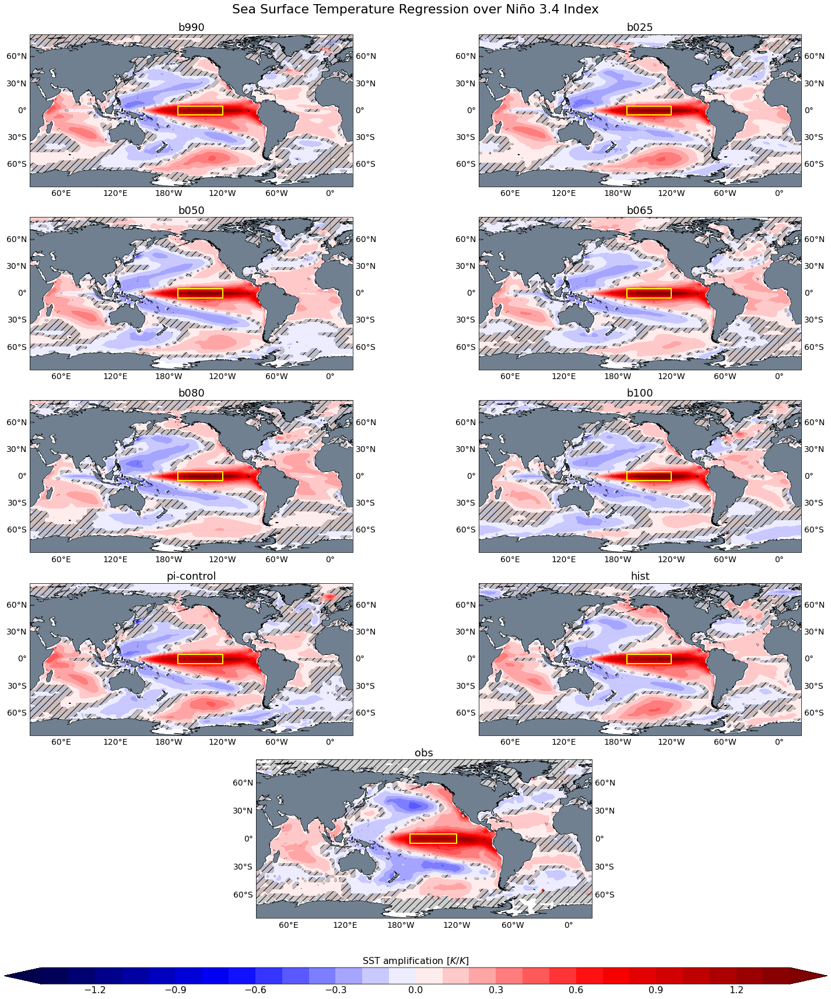

In [9]:
################################################################################################
###################### SST & p value Regression over Ninõ 3.4 Index ############################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-1.4, 1.4, 29)
levels=np.round(levels, 1)

for i, datasetN in enumerate(dataset_names):
   row = i // 2
   col = i % 2
   # Adds coastlines to the current axes
   res = '50m'
   axs[row, col].coastlines(resolution=res, linewidths=0.5)
   # Turn on continent shading
   axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
   #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
   #ax.set_global()
   # Hide white longitude line
   cyclic = True
   lon_Of = lonO.copy() # first contourf()
   lon_Off = lonO.copy() # second contourf()
   variables_dict['trend']['tos'][datasetN], lon_Of = cutil.add_cyclic_point(variables_dict['trend']['tos'][datasetN], coord = lon_Of)
   variables_dict['pval']['tos'][datasetN], lon_Off = cutil.add_cyclic_point(variables_dict['pval']['tos'][datasetN], coord = lon_Off)
   # Contourf-plot data
   scalar = axs[row, col].contourf(lon_Of, latO, variables_dict['trend']['tos'][datasetN], cmap='seismic', transform=proj0,
                        levels=levels, extend='both')
   #scalar.set_clim(-6,6)
   # Set a title for the axes.
   axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
   #p-value/significativity shading
   density=2
   scalarH = axs[row, col].contourf(lon_Off, latO, variables_dict['pval']['tos'][datasetN] > 0.05, transform=proj0, colors='none',
               levels=[0.5,1.5], hatches=[density*'/'], alpha=0.2) #ALPHA setta la trasparenza
   # Create a legend for the hatches contour set
   #artists, labels = scalarH.legend_elements(str_format='{:2.1f}'.format)
   #labels = ['p-value > 0.05']
   #legend = ax.legend(artists, labels, handleheight=2, framealpha=1, loc = 'upper left', frameon=True)
   #legend.set_zorder(100) # Posiziona la legenda in primo piano
   #legend.set_in_layout(False)
   # Ninō 3.4 Box
   x=[lon_east, lon_west, lon_west, lon_east, lon_east]
   y=[lat_south, lat_south, lat_north, lat_north, lat_south]
   axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
   #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
   # Set axis features
   gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels =True
   gl.bottom_labels = False
   gl.top_labels = False
   gl.right_labels = True
   gl.xlines = True
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
   # Set axis features:
      # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
   gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels = False
   gl.bottom_labels =True
   gl.top_labels = False
   gl.right_labels = False
   gl.xlines = False
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
axs[4, 0].set_position([0.31, 0.01, 0.4, 0.2]) # [left, bottom, width, height]
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('SST amplification ' r'$[K/K]$', fontsize=16)
fig.delaxes(axs.flatten()[i+1]) # Cancello il subplot vuoto
plt.suptitle('Sea Surface Temperature Regression over Niño 3.4 Index', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_SST-NinoIndex.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_SST-NinoIndex.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

/tmp/ipykernel_2839/4061949253.py:72: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


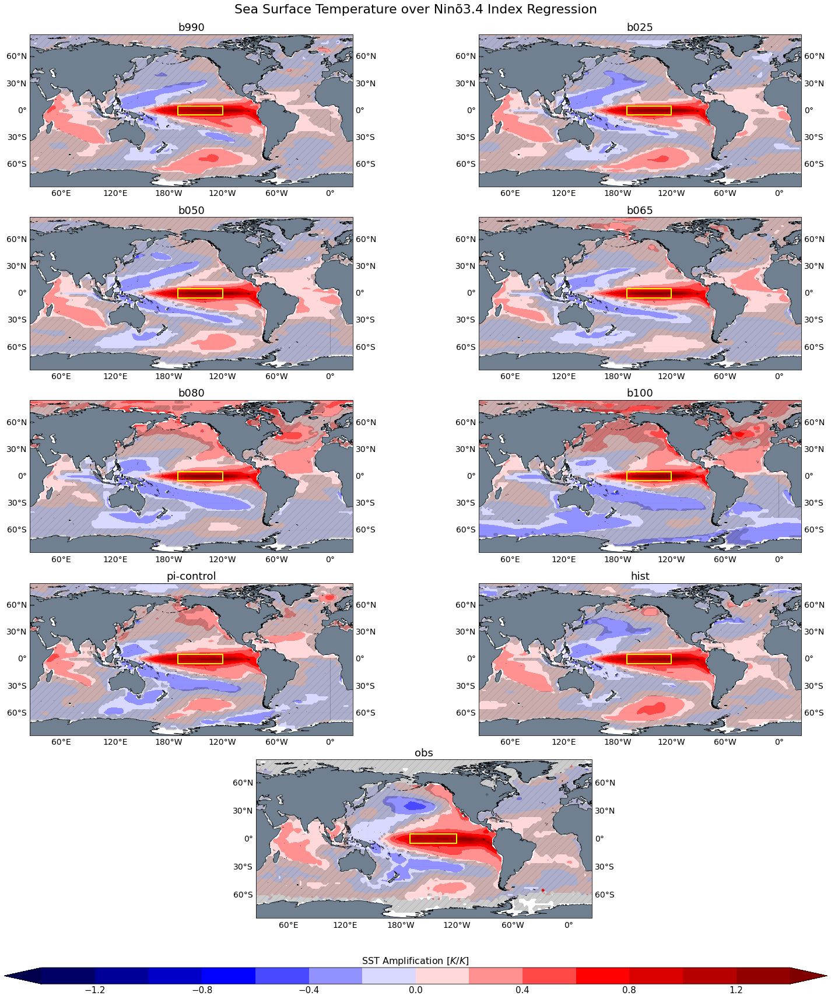

In [19]:
QUI NEL CAMPO è ANCORA PRESENTE IL SEASONAL CYCLE

################################################################################################
###################### SST & p value Regression over Ninõ 3.4 Index ############################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-1.4, 1.4, 15)
levels=np.round(levels, 1)

for i, datasetN in enumerate(dataset_names):
   row = i // 2
   col = i % 2
   # Adds coastlines to the current axes
   res = '50m'
   axs[row, col].coastlines(resolution=res, linewidths=0.5)
   # Turn on continent shading
   axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
   #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
   #ax.set_global()
   # Hide white longitude line
   cyclic = True
   lon_Of = lonO.copy() # first contourf()
   lon_Off = lonO.copy() # second contourf()
   variables_dict['trend']['tos'][datasetN], lon_Of = cutil.add_cyclic_point(variables_dict['trend']['tos'][datasetN], coord = lon_Of)
   variables_dict['pval']['tos'][datasetN], lon_Off = cutil.add_cyclic_point(variables_dict['pval']['tos'][datasetN], coord = lon_Off)
   # Contourf-plot data
   scalar = axs[row, col].contourf(lon_Of, latO, variables_dict['trend']['tos'][datasetN], cmap='seismic', transform=proj0,
                        levels=levels, extend='both')
   #scalar.set_clim(-6,6)
   # Set a title for the axes.
   axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
   #p-value/significativity shading
   density=2
   scalarH = axs[row, col].contourf(lon_Off, latO, variables_dict['pval']['tos'][datasetN] > 0.05, transform=proj0, colors='none',
               levels=[0.5,1.5], hatches=[density*'/'], alpha=0.2) #ALPHA setta la trasparenza
   # Create a legend for the hatches contour set
   #artists, labels = scalarH.legend_elements(str_format='{:2.1f}'.format)
   #labels = ['p-value > 0.05']
   #legend = ax.legend(artists, labels, handleheight=2, framealpha=1, loc = 'upper left', frameon=True)
   #legend.set_zorder(100) # Posiziona la legenda in primo piano
   #legend.set_in_layout(False)
   # Ninō 3.4 Box
   x=[lon_east, lon_west, lon_west, lon_east, lon_east]
   y=[lat_south, lat_south, lat_north, lat_north, lat_south]
   axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
   #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
   # Set axis features
   gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels =True
   gl.bottom_labels = False
   gl.top_labels = False
   gl.right_labels = True
   gl.xlines = True
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
   # Set axis features:
      # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
   gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels = False
   gl.bottom_labels =True
   gl.top_labels = False
   gl.right_labels = False
   gl.xlines = False
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
axs[4, 0].set_position([0.31, 0.01, 0.4, 0.2]) # [left, bottom, width, height]
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.set_title('SST amplification ' r'$[K/K]$', fontsize=16)
fig.delaxes(axs.flatten()[i+1]) # Cancello il subplot vuoto
plt.suptitle('Sea Surface Temperature over Niño 3.4 Index Regression', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
#fig.savefig(common_Dir_home + dir_Images6 + 'Regression_SST-NinoIndex.pdf', bbox_inches='tight', dpi=300)
# Display the figure
plt.show()   

In [15]:
for datasetN in dataset_names:
      print(datasetN)
      print("min e max SST Composite Nino + Nina")
      print(np.nanmin(composite_dict['nino']['tos'][datasetN]+composite_dict['nina']['tos'][datasetN]), np.nanmax(composite_dict['nino']['tos'][datasetN]+composite_dict['nina']['tos'][datasetN]))

b990
min e max SST Composite Nino + Nina
-0.3045939 0.43435314
b025
min e max SST Composite Nino + Nina
-0.33060536 0.44843596
b050
min e max SST Composite Nino + Nina
-0.3147524 0.28431767
b065
min e max SST Composite Nino + Nina
-0.44392344 0.31954834
b080
min e max SST Composite Nino + Nina
-0.24833524 0.3933262
b100
min e max SST Composite Nino + Nina
-0.34460822 0.23212788
pi-control
min e max SST Composite Nino + Nina
-0.5261137 0.61074746
hist
min e max SST Composite Nino + Nina
-0.3353 0.29712915
obs
min e max SST Composite Nino + Nina
-0.5180087 0.8041267


/tmp/ipykernel_18070/2045054761.py:63: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


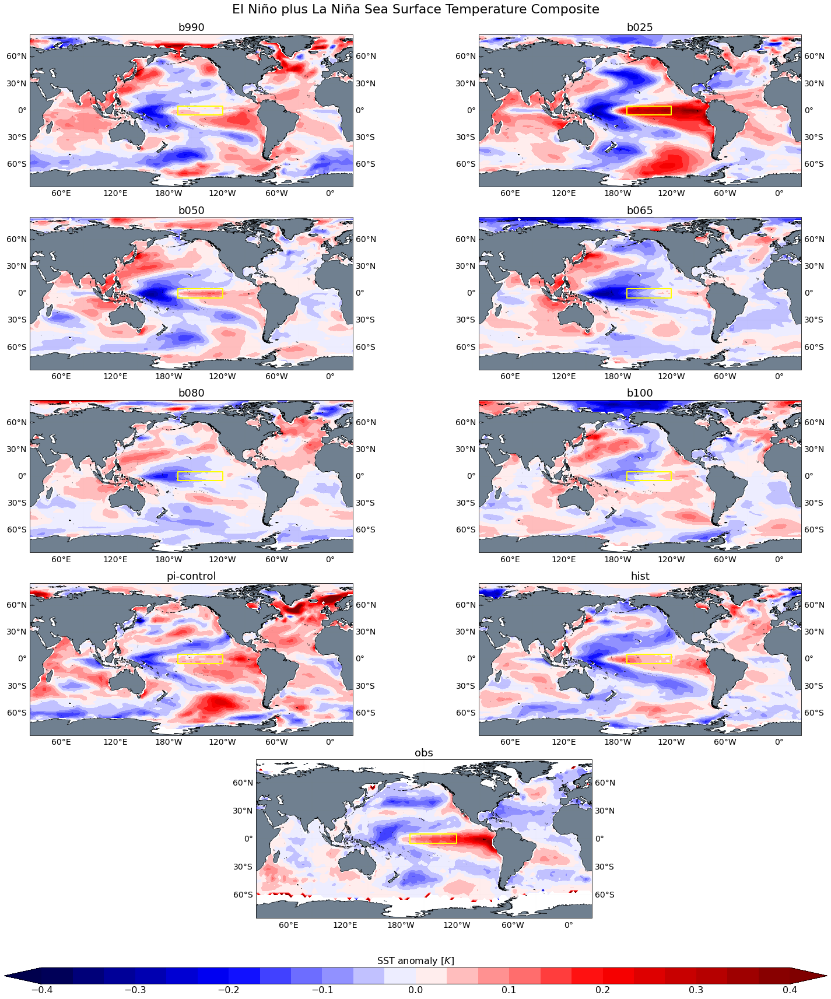

In [42]:
################################################################################################
########################## SST composite maps for Ninõ 3.4 Index ###############################
######################################### Nino + Nina ##########################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-0.4, 0.4, 25)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   row = i // 2
   col = i % 2
   # Adds coastlines to the current axes
   res = '50m'
   axs[row, col].coastlines(resolution=res, linewidths=0.5)
   # Turn on continent shading
   axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
   #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
   #ax.set_global()
   sum = composite_dict['nino']['tos'][datasetN]+composite_dict['nina']['tos'][datasetN]
   # Hide white longitude line
   cyclic = True
   lon_Of = lonO.copy() # first contourf()
   lon_Off = lonO.copy() # second contourf()
   sum, lon_Of = cutil.add_cyclic_point(sum, coord = lon_Of)
   # Contourf-plot data
   scalar = axs[row, col].contourf(lon_Of, latO, sum, cmap='seismic', transform=proj0,
                        levels=levels, extend='both')
   #scalar.set_clim(-6,6)
   # Set a title for the axes.
   axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
   # Ninō 3.4 Box
   x=[lon_east, lon_west, lon_west, lon_east, lon_east]
   y=[lat_south, lat_south, lat_north, lat_north, lat_south]
   axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
   #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
   # Set axis features
   gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels =True
   gl.bottom_labels = False
   gl.top_labels = False
   gl.right_labels = True
   gl.xlines = True
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
   # Set axis features:
      # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
   gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels = False
   gl.bottom_labels =True
   gl.top_labels = False
   gl.right_labels = False
   gl.xlines = False
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
axs[4, 0].set_position([0.31, 0.01, 0.4, 0.2]) # [left, bottom, width, height]
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('SST anomaly ' r'$[K]$', fontsize=16)
fig.delaxes(axs.flatten()[i+1]) # Cancello il subplot vuoto
plt.suptitle('El Niño plus La Niña Sea Surface Temperature Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_SST-NinoNina.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_SST-NinoNina.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [17]:
for datasetN in dataset_names:
      print(datasetN)
      print("min e max SST Composite Nino")
      print(np.nanmin(composite_dict['nino']['tos'][datasetN]), np.nanmax(composite_dict['nino']['tos'][datasetN]))

b990
min e max SST Composite Nino
-0.47530016 1.3630607
b025
min e max SST Composite Nino
-0.7327549 1.9157213
b050
min e max SST Composite Nino
-0.6027887 1.946455
b065
min e max SST Composite Nino
-0.6637262 2.0010548
b080
min e max SST Composite Nino
-0.69839287 1.7093127
b100
min e max SST Composite Nino
-0.49977 1.6358947
pi-control
min e max SST Composite Nino
-0.99023265 1.2325932
hist
min e max SST Composite Nino
-0.648804 1.2906547
obs
min e max SST Composite Nino
-0.583367 1.2266833


/tmp/ipykernel_18070/3707948825.py:61: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


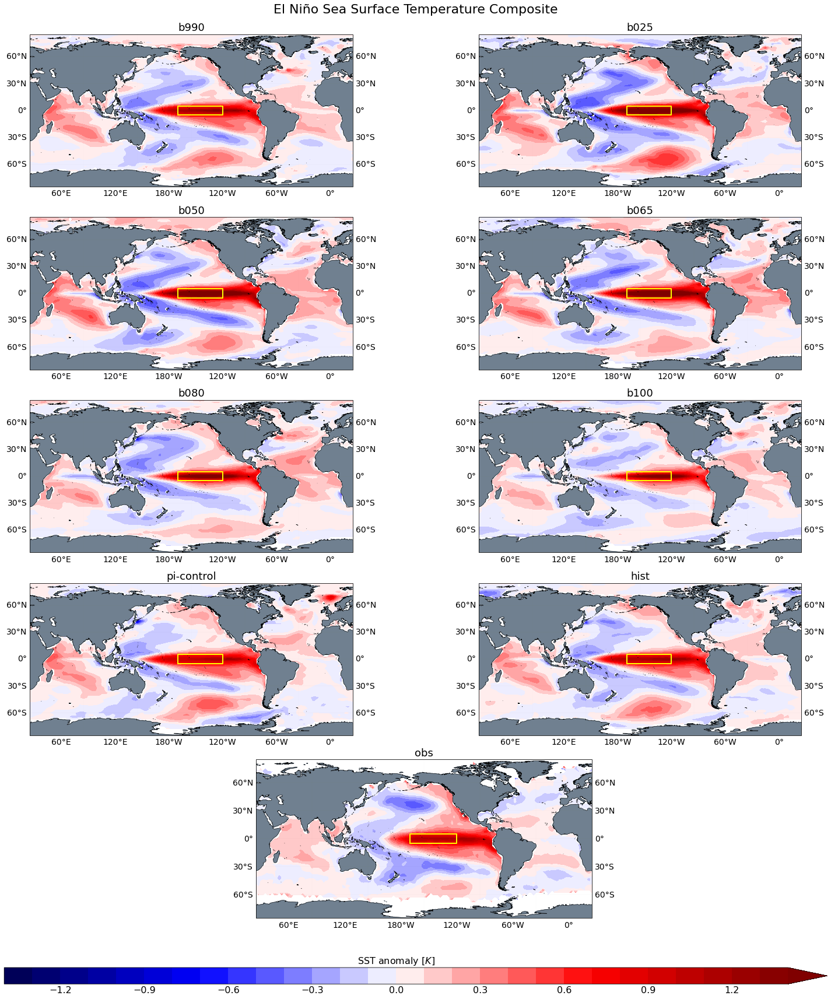

In [43]:
################################################################################################
########################## SST composite maps for Ninõ 3.4 Index ###############################
########################################### Nino ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-1.4, 1.4, 29)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   row = i // 2
   col = i % 2
   # Adds coastlines to the current axes
   res = '50m'
   axs[row, col].coastlines(resolution=res, linewidths=0.5)
   # Turn on continent shading
   axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
   #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
   #ax.set_global()
   # Hide white longitude line
   cyclic = True
   lon_Of = lonO.copy()
   composite_dict['nino']['tos'][datasetN], lon_Of = cutil.add_cyclic_point(composite_dict['nino']['tos'][datasetN], coord = lon_Of)
   # Contourf-plot data
   scalar = axs[row, col].contourf(lon_Of, latO, composite_dict['nino']['tos'][datasetN], cmap='seismic', transform=proj0,
                        levels=levels, extend='max')
   #scalar.set_clim(-6,6)
   # Set a title for the axes.
   axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
   # Ninō 3.4 Box
   x=[lon_east, lon_west, lon_west, lon_east, lon_east]
   y=[lat_south, lat_south, lat_north, lat_north, lat_south]
   axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
   #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
   # Set axis features
   gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels =True
   gl.bottom_labels = False
   gl.top_labels = False
   gl.right_labels = True
   gl.xlines = True
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
   # Set axis features:
      # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
   gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels = False
   gl.bottom_labels =True
   gl.top_labels = False
   gl.right_labels = False
   gl.xlines = False
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
axs[4, 0].set_position([0.31, 0.01, 0.4, 0.2]) # [left, bottom, width, height]
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('SST anomaly ' r'$[K]$', fontsize=16)
fig.delaxes(axs.flatten()[i+1]) # Cancello il subplot vuoto
plt.suptitle('El Niño Sea Surface Temperature Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_SST-Nino.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_SST-Nino.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [19]:
for datasetN in dataset_names:
      print(datasetN)
      print("min e max SST Composite Nino discrepance from pi-control")
      print(np.nanmin(composite_dict['nino']['tos'][datasetN] - composite_dict['nino']['tos']['pi-control']), np.nanmax(composite_dict['nino']['tos'][datasetN] - composite_dict['nino']['tos']['pi-control']))

b990
min e max SST Composite Nino discrepance from pi-control
-0.898966 0.89101005
b025
min e max SST Composite Nino discrepance from pi-control
-0.8251385 0.76883876
b050
min e max SST Composite Nino discrepance from pi-control
-0.82264996 0.83984864
b065
min e max SST Composite Nino discrepance from pi-control
-0.81298435 0.86588895
b080
min e max SST Composite Nino discrepance from pi-control
-0.74558717 0.6167176
b100
min e max SST Composite Nino discrepance from pi-control
-0.784453 0.548255
pi-control
min e max SST Composite Nino discrepance from pi-control
0.0 0.0
hist
min e max SST Composite Nino discrepance from pi-control
-0.9045812 0.4882239
obs
min e max SST Composite Nino discrepance from pi-control
-0.8857681 0.6068469


/tmp/ipykernel_18070/864710029.py:65: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


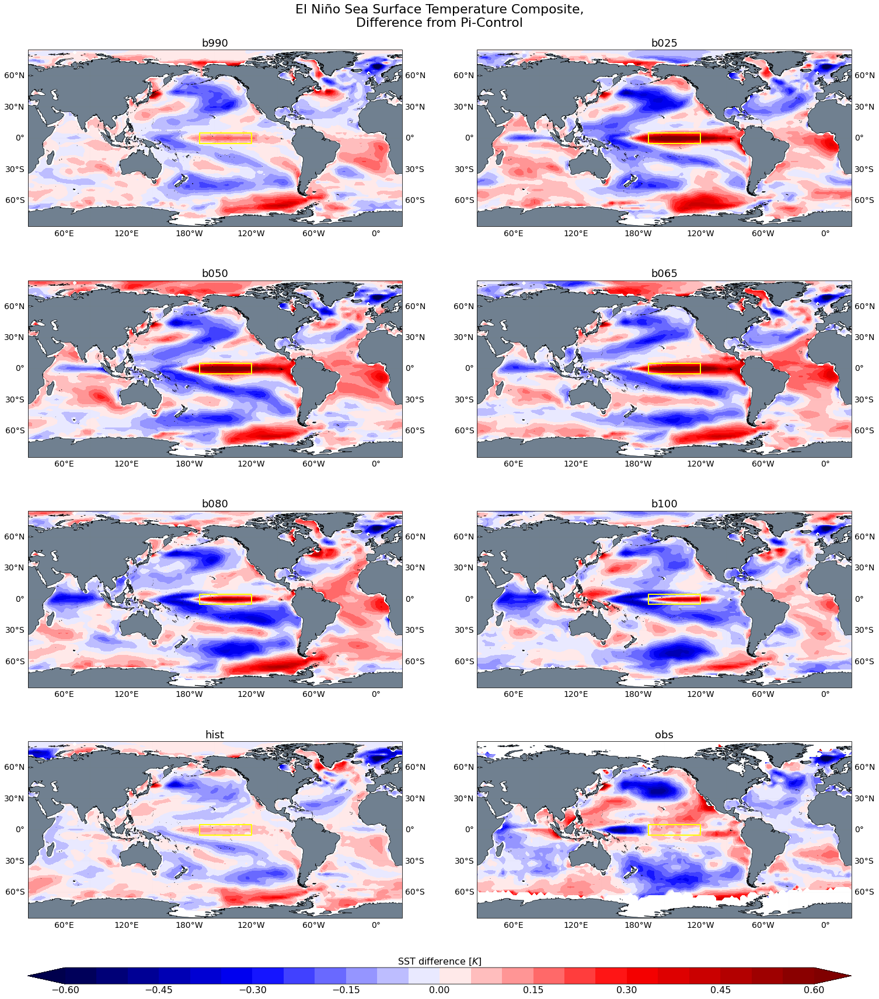

In [47]:
################################################################################################
########################## SST composite maps for Ninõ 3.4 Index ###############################
################################# Discrepance from pi-control ##################################
########################################### Nino ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-0.6, 0.6, 25)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if i >= 6:
        i-=1
   if datasetN not in ['pi-control']:
         discrepance = composite_dict['nino']['tos'][datasetN] - composite_dict['nino']['tos']['pi-control']
         row = i // 2
         col = i % 2
         # Adds coastlines to the current axes
         res = '50m'
         axs[row, col].coastlines(resolution=res, linewidths=0.5)
         # Turn on continent shading
         axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
         #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
         #ax.set_global()
         # Hide white longitude line
         cyclic = True
         lon_Of = lonO.copy()
         discrepance, lon_Of = cutil.add_cyclic_point(discrepance, coord = lon_Of)
         # Contourf-plot data
         scalar = axs[row, col].contourf(lon_Of, latO, discrepance, cmap='seismic', transform=proj0,
                              levels=levels, extend='both')
         #scalar.set_clim(-6,6)
         # Set a title for the axes.
         axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
         # Ninō 3.4 Box
         x=[lon_east, lon_west, lon_west, lon_east, lon_east]
         y=[lat_south, lat_south, lat_north, lat_north, lat_south]
         axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
         #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
         # Set axis features
         gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
         gl.left_labels =True
         gl.bottom_labels = False
         gl.top_labels = False
         gl.right_labels = True
         gl.xlines = True
         gl.xformatter = LONGITUDE_FORMATTER
         gl.yformatter = LATITUDE_FORMATTER
         gl.xlabel_style = {'size': 14, 'color': 'black'}
         gl.ylabel_style = {'size': 14, 'color': 'black'}
         # Set axis features:
            # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
         gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
         gl.left_labels = False
         gl.bottom_labels =True
         gl.top_labels = False
         gl.right_labels = False
         gl.xlines = False
         gl.xformatter = LONGITUDE_FORMATTER
         gl.yformatter = LATITUDE_FORMATTER
         gl.xlabel_style = {'size': 14, 'color': 'black'}
         gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('SST difference ' r'$[K]$', fontsize=16)
plt.suptitle('El Niño Sea Surface Temperature Composite,\nDifference from Pi-Control', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_SST-Nino-Discrep.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_SST-Nino-Discrep.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [51]:
for datasetN in dataset_names:
      print(datasetN)
      print("min e max SST Composite Nina")
      print(np.nanmin(composite_dict['nina']['tos'][datasetN]), np.nanmax(composite_dict['nina']['tos'][datasetN]))

b990
min e max SST Composite Nino
-1.3722366 0.5166169
b025
min e max SST Composite Nino
-1.5638344 0.51066655
b050
min e max SST Composite Nino
-1.8175144 0.7214534
b065
min e max SST Composite Nino
-1.9756435 0.8132087
b080
min e max SST Composite Nino
-1.6834424 0.5952709
b100
min e max SST Composite Nino
-1.5765718 0.57301986
pi-control
min e max SST Composite Nino
-1.1387534 0.57911533
hist
min e max SST Composite Nino
-1.253727 0.7991379
obs
min e max SST Composite Nino
-1.0271615 0.59706223


/tmp/ipykernel_18070/1155349016.py:61: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


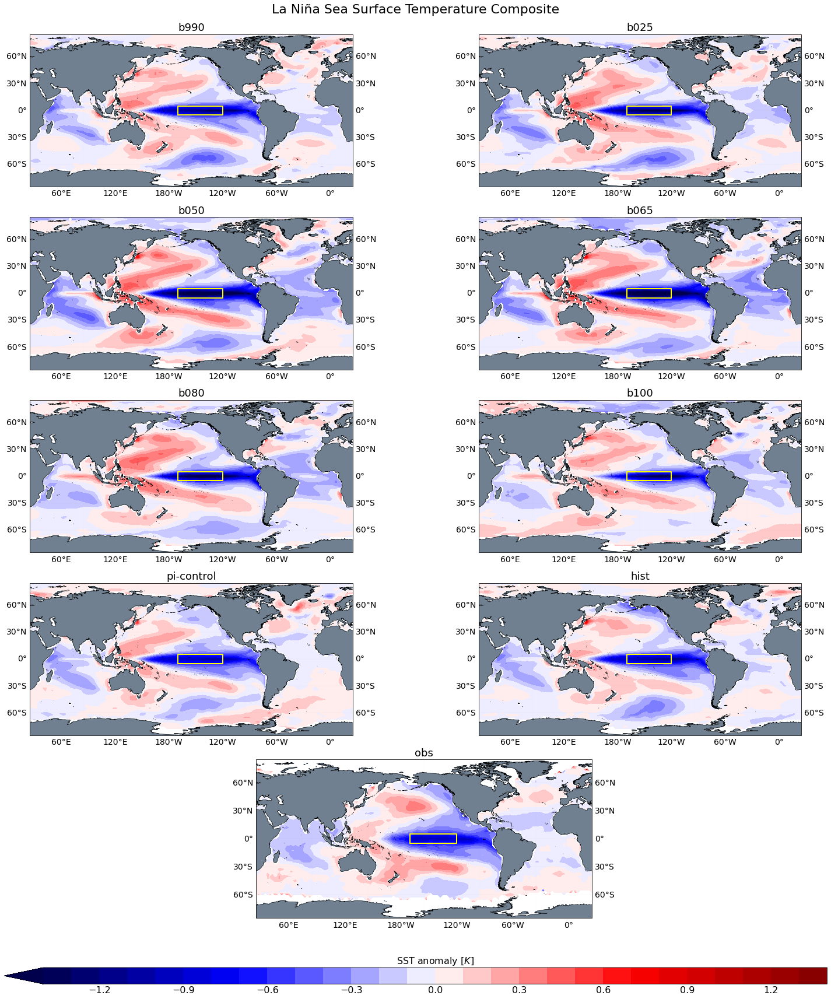

In [45]:
################################################################################################
########################## SST composite maps for Ninõ 3.4 Index ###############################
########################################### Nina ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-1.4, 1.4, 29)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   row = i // 2
   col = i % 2
   # Adds coastlines to the current axes
   res = '50m'
   axs[row, col].coastlines(resolution=res, linewidths=0.5)
   # Turn on continent shading
   axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
   #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
   #ax.set_global()
   # Hide white longitude line
   cyclic = True
   lon_Of = lonO.copy()
   composite_dict['nina']['tos'][datasetN], lon_Of = cutil.add_cyclic_point(composite_dict['nina']['tos'][datasetN], coord = lon_Of)
   # Contourf-plot data
   scalar = axs[row, col].contourf(lon_Of, latO, composite_dict['nina']['tos'][datasetN], cmap='seismic', transform=proj0,
                        levels=levels, extend='min')
   #scalar.set_clim(-6,6)
   # Set a title for the axes.
   axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
   # Ninō 3.4 Box
   x=[lon_east, lon_west, lon_west, lon_east, lon_east]
   y=[lat_south, lat_south, lat_north, lat_north, lat_south]
   axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
   #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
   # Set axis features
   gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels =True
   gl.bottom_labels = False
   gl.top_labels = False
   gl.right_labels = True
   gl.xlines = True
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
   # Set axis features:
      # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
   gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels = False
   gl.bottom_labels =True
   gl.top_labels = False
   gl.right_labels = False
   gl.xlines = False
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
axs[4, 0].set_position([0.31, 0.01, 0.4, 0.2]) # [left, bottom, width, height]
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('SST anomaly ' r'$[K]$', fontsize=16)
fig.delaxes(axs.flatten()[i+1]) # Cancello il subplot vuoto
plt.suptitle('La Niña Sea Surface Temperature Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_SST-Nina.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_SST-Nina.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [4]:
for datasetN in dataset_names:
   if datasetN not in dataset_names_excluded:
      print(datasetN)
      print("min e max T2m")
      print(np.nanmin(variables_dict['trend']['tas'][datasetN]), np.nanmax(variables_dict['trend']['tas'][datasetN]))

b990
min e max T2m
-0.8750883395047145 1.119507376414809
b025
min e max T2m
-0.7440282402208901 1.0466084177232164
b050
min e max T2m
-0.5824219188388479 1.0131812816991483
b065
min e max T2m
-0.6954039558391567 1.0094934874743862
b080
min e max T2m
-0.5543526029581972 1.0553236777919526
b100
min e max T2m
-0.6730056171244685 1.255082568563763
pi-control
min e max T2m
-0.81076539734365 1.1018286780782105
hist
min e max T2m
-0.868399228275 1.1237484666290338


/home/montanarini/miniconda3/envs/ctl4b/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1714: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contourf(self, *args, **kwargs)
/tmp/ipykernel_18070/2737372969.py:74: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


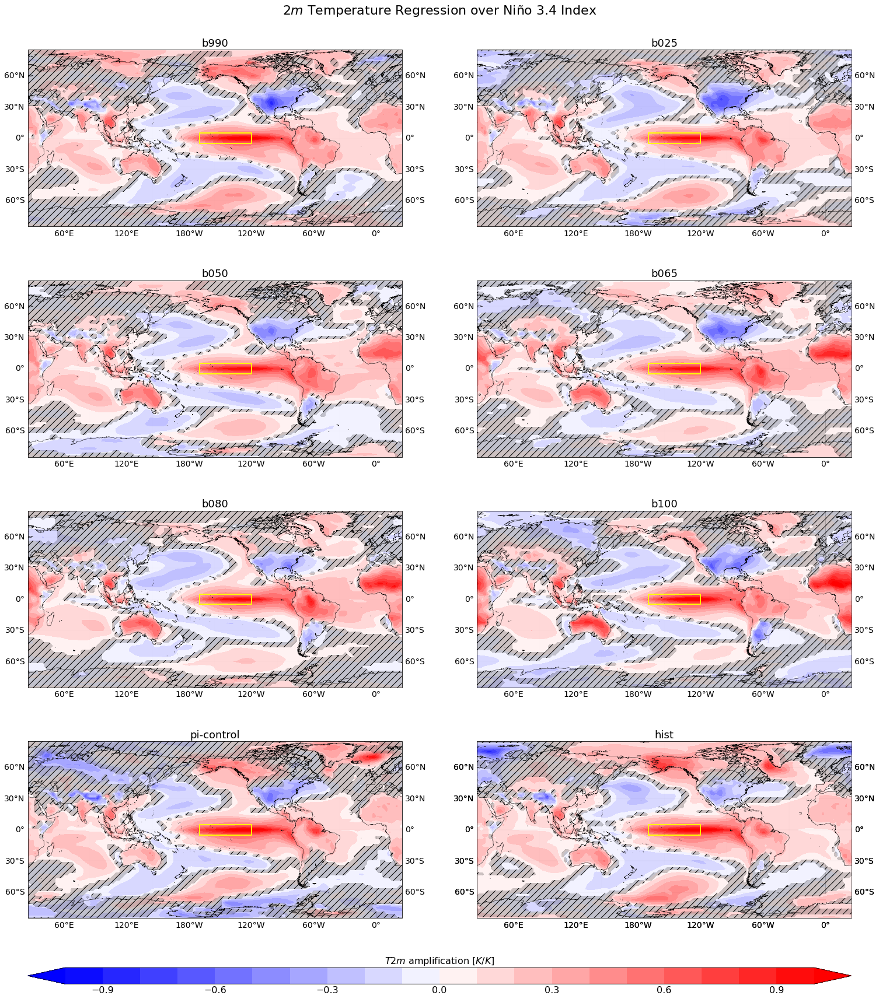

In [23]:
################################################################################################
##################### T2m & p value Regression over Ninõ 3.4 Index #############################
################################################################################################
plt.style.use('_mpl-gallery')

fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))

# levels of plot
levels=np.linspace(-1, 1, 21)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_Of = lonO.copy()
      lon_Off = lonO.copy()
      variables_dict['trend']['tas'][datasetN], lon_Of = cutil.add_cyclic_point(variables_dict['trend']['tas'][datasetN], coord = lon_Of)
      variables_dict['pval']['tas'][datasetN], lon_Off = cutil.add_cyclic_point(variables_dict['pval']['tas'][datasetN], coord = lon_Off)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, variables_dict['trend']['tas'][datasetN], cmap='bwr', transform=proj0,
                           levels=levels, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      #p-value/significativity shading
      density=2
      scalarH = axs[row, col].contourf(lon_Off, latO, variables_dict['pval']['tas'][datasetN] > 0.05, transform=proj0, colors='none',
                  levels=[0.5,1.5], hatches=[density*'/'], linestyle=0.5, alpha=0.2) #ALPHA setta la trasparenza
      # Create a legend for the hatches contour set
      #artists, labels = scalarH.legend_elements(str_format='{:2.1f}'.format)
      #labels = ['p-value > 0.05']
      #legend = ax.legend(artists, labels, handleheight=2, framealpha=1, loc = 'upper left', frameon=True)
      #legend.set_zorder(100) # Posiziona la legenda in primo piano
      #legend.set_in_layout(False)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
   # Set axis features
   gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels =True
   gl.bottom_labels = False
   gl.top_labels = False
   gl.right_labels = True
   gl.xlines = True
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
   # Set axis features:
      # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
   gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels = False
   gl.bottom_labels =True
   gl.top_labels = False
   gl.right_labels = False
   gl.xlines = False
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title(r'$T2m$' ' amplification ' r'$[K/K]$', fontsize=16)
# Cancello il subplot vuoto
#fig.delaxes(axs.flatten()[i+1])
plt.suptitle(r'$2m$' ' Temperature Regression over Niño 3.4 Index', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_T2m-NinoIndex.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_T2m-NinoIndex.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()

/tmp/ipykernel_8268/4272599745.py:74: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


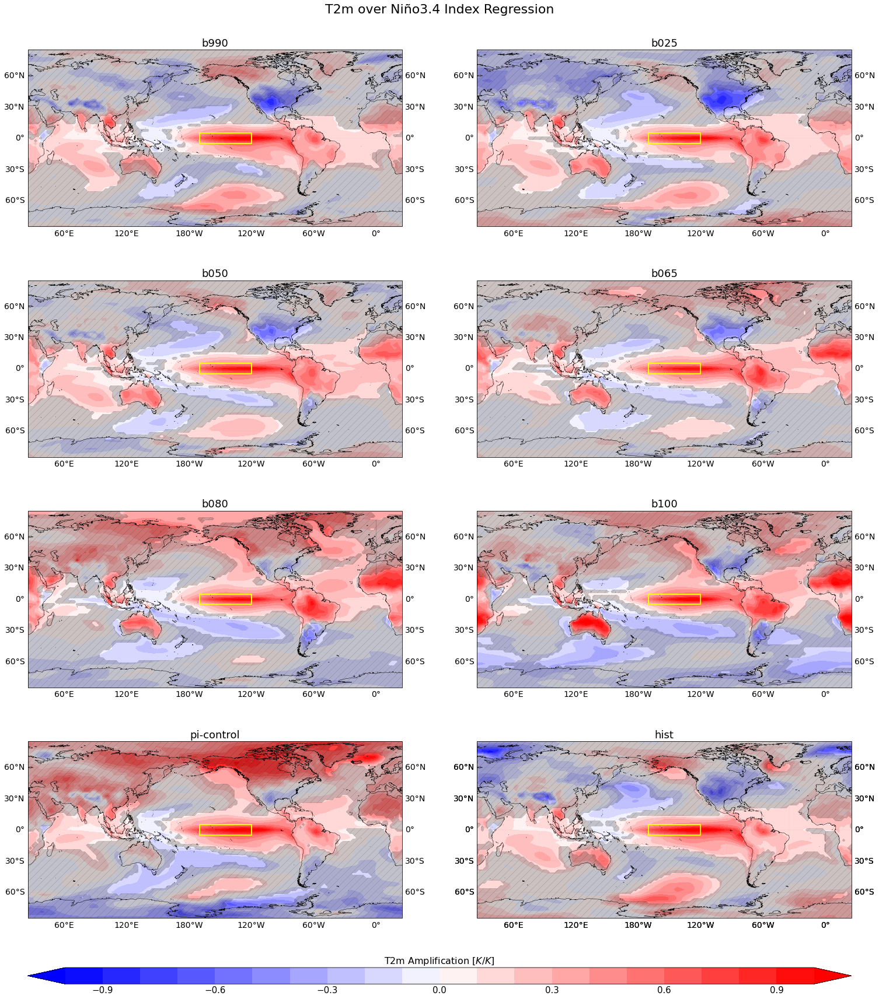

In [27]:
QUI NEL CAMPO è ANCORA PRESENTE IL SEASONAL CYCLE
################################################################################################
##################### T2m & p value Regression over Ninõ 3.4 Index #############################
################################################################################################
plt.style.use('_mpl-gallery')

fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))

# levels of plot
levels=np.linspace(-1, 1, 21)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_Of = lonO.copy()
      variables_dict['trend']['tas'][datasetN], lon_Of = cutil.add_cyclic_point(variables_dict['trend']['tas'][datasetN], coord = lon_Of)
      variables_dict['pval']['tas'][datasetN], lon_Off = cutil.add_cyclic_point(variables_dict['pval']['tas'][datasetN], coord = lon_Off)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, variables_dict['trend']['tas'][datasetN], cmap='bwr', transform=proj0,
                           levels=levels, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      #p-value/significativity shading
      density=2
      scalarH = axs[row, col].contourf(lon_Off, latO, variables_dict['pval']['tas'][datasetN] > 0.05, transform=proj0, colors='none',
                  levels=[0.5,1.5], hatches=[density*'/'], alpha=0.2) #ALPHA setta la trasparenza
      # Create a legend for the hatches contour set
      #artists, labels = scalarH.legend_elements(str_format='{:2.1f}'.format)
      #labels = ['p-value > 0.05']
      #legend = ax.legend(artists, labels, handleheight=2, framealpha=1, loc = 'upper left', frameon=True)
      #legend.set_zorder(100) # Posiziona la legenda in primo piano
      #legend.set_in_layout(False)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
   # Set axis features
   gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels =True
   gl.bottom_labels = False
   gl.top_labels = False
   gl.right_labels = True
   gl.xlines = True
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
   # Set axis features:
      # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
   gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
   gl.left_labels = False
   gl.bottom_labels =True
   gl.top_labels = False
   gl.right_labels = False
   gl.xlines = False
   gl.xformatter = LONGITUDE_FORMATTER
   gl.yformatter = LATITUDE_FORMATTER
   gl.xlabel_style = {'size': 14, 'color': 'black'}
   gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.set_title(r'T2m' ' amplification ' r'$[K/K]$', fontsize=16)
# Cancello il subplot vuoto
#fig.delaxes(axs.flatten()[i+1])
plt.suptitle(r'2m$' ' Temperature over Niño 3.4 Index Regression', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_T2m-NinoIndex.pdf', bbox_inches='tight', dpi=300)
# Display the figure
plt.show()

In [6]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max T2m Composite Nino + Nina")
            print(np.nanmin(composite_dict['nino']['tas'][datasetN]+composite_dict['nina']['tas'][datasetN]), np.nanmax(composite_dict['nino']['tas'][datasetN]+composite_dict['nina']['tas'][datasetN]))

b990
min e max T2m Composite Nino + Nina
-0.28884876 0.68112576
b025
min e max T2m Composite Nino + Nina
-0.36060217 0.6250396
b050
min e max T2m Composite Nino + Nina
-0.24083447 0.27294454
b065
min e max T2m Composite Nino + Nina
-0.3112764 0.23307446
b080
min e max T2m Composite Nino + Nina
-0.32635802 0.33464938
b100
min e max T2m Composite Nino + Nina
-0.34409514 0.43392608
pi-control
min e max T2m Composite Nino + Nina
-0.6258294 0.96373165
hist
min e max T2m Composite Nino + Nina
-0.4748247 0.31735164


/tmp/ipykernel_18070/1529589930.py:62: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


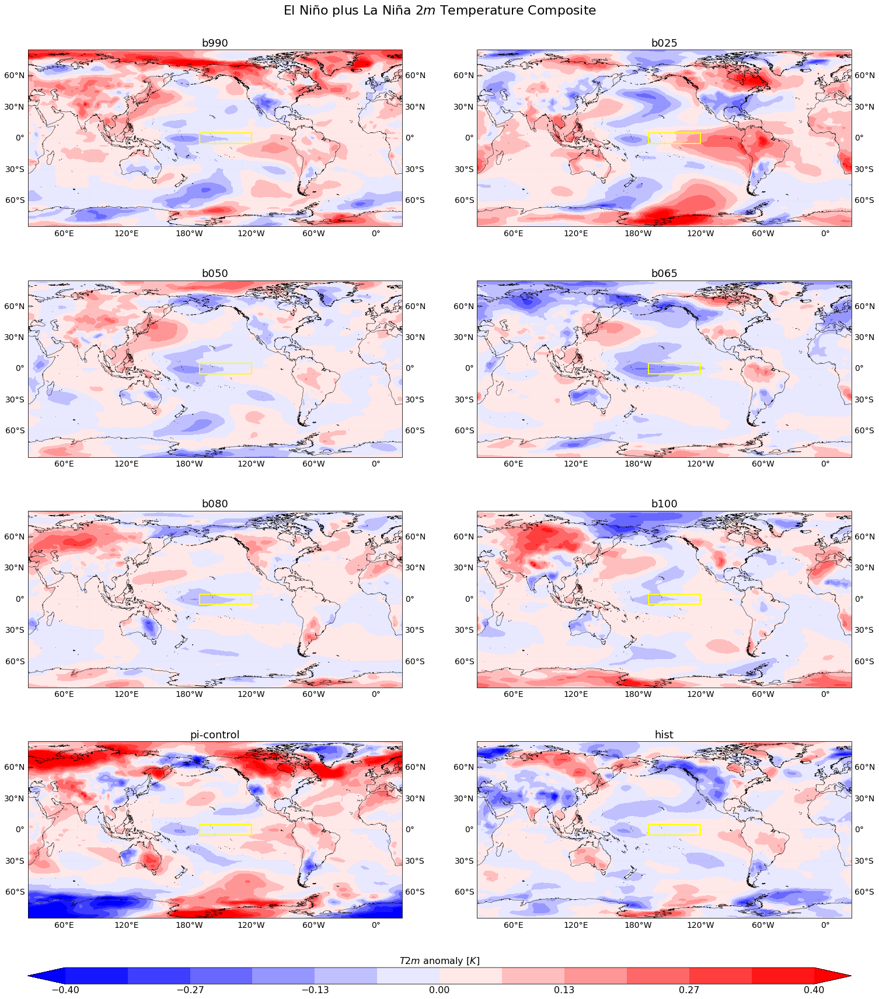

In [48]:
################################################################################################
########################## T2m composite maps for Ninõ 3.4 Index ###############################
######################################### Nino + Nina ##########################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-0.4, 0.4, 13)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      sum = composite_dict['nino']['tas'][datasetN]+composite_dict['nina']['tas'][datasetN]
      cyclic = True
      lon_Of = lonO.copy()
      sum, lon_Of = cutil.add_cyclic_point(sum, coord = lon_Of)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, sum, cmap='bwr', transform=proj0,
                           levels=levels, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title(r'$T2m$' ' anomaly ' r'$[K]$', fontsize=16)
plt.suptitle('El Niño plus La Niña 'r'$2m$' ' Temperature Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_T2m-NinoNina.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_T2m-NinoNina.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [8]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max T2m Composite Nino")
            print(np.nanmin(composite_dict['nino']['tas'][datasetN]), np.nanmax(composite_dict['nino']['tas'][datasetN]))

b990
min e max T2m Composite Nino
-0.9119814 1.1274163
b025
min e max T2m Composite Nino
-1.0339789 1.3544647
b050
min e max T2m Composite Nino
-0.9099531 1.3490777
b065
min e max T2m Composite Nino
-0.9579306 1.3390079
b080
min e max T2m Composite Nino
-0.64803714 1.081561
b100
min e max T2m Composite Nino
-0.68332607 1.0913495
pi-control
min e max T2m Composite Nino
-0.7835671 1.0392938
hist
min e max T2m Composite Nino
-0.9286461 1.0615777


/tmp/ipykernel_18070/1628417625.py:61: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


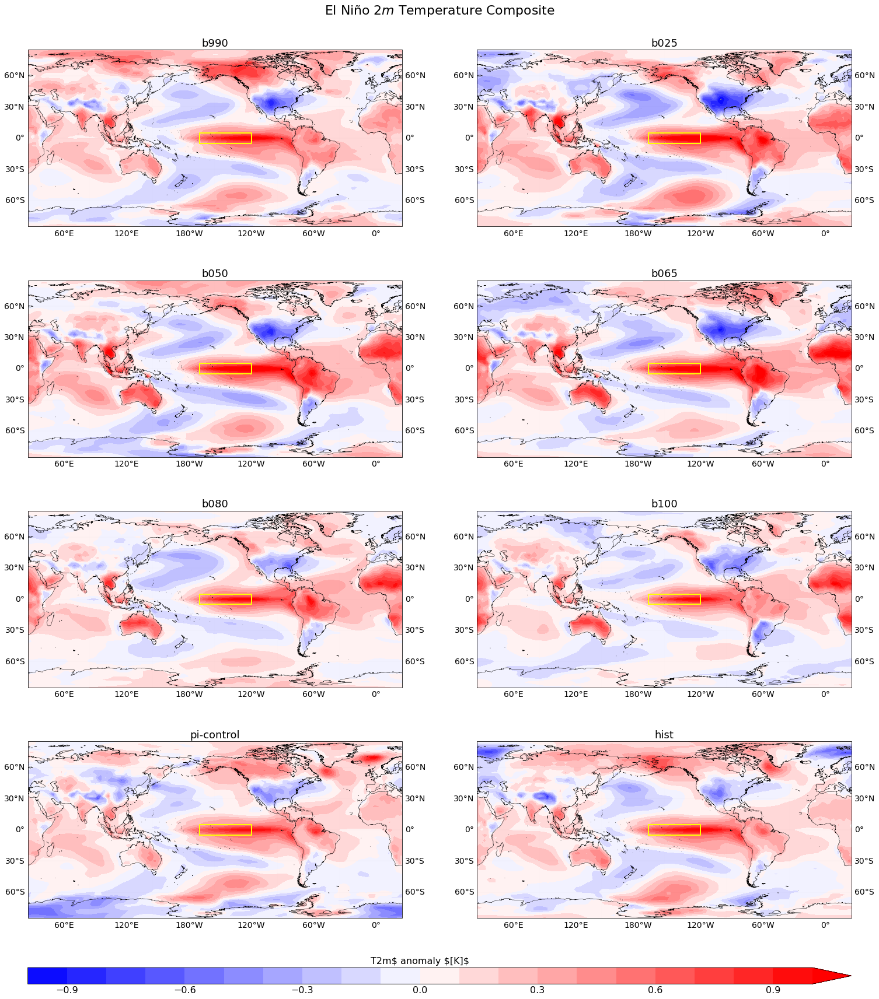

In [40]:
################################################################################################
########################## T2m composite maps for Ninõ 3.4 Index ###############################
########################################### Nino ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-1, 1, 21)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_Of = lonO.copy()
      composite_dict['nino']['tas'][datasetN], lon_Of = cutil.add_cyclic_point(composite_dict['nino']['tas'][datasetN], coord = lon_Of)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, composite_dict['nino']['tas'][datasetN], cmap='bwr', transform=proj0,
                           levels=levels, extend='max')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title(r'T2m$' ' anomaly ' r'$[K]$', fontsize=16)
plt.suptitle('El Niño 'r'$2m$' ' Temperature Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_T2m-Nino.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_T2m-Nino.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [5]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max T2m Composite Nino discrepance from pi-control")
            print(np.nanmin(composite_dict['nino']['tas'][datasetN]-composite_dict['nino']['tas']['pi-control']), np.nanmax(composite_dict['nino']['tas'][datasetN]-composite_dict['nino']['tas']['pi-control']))

b990
min e max T2m Composite Nino discrepance from pi-control
-1.1198399 0.66444224
b025
min e max T2m Composite Nino discrepance from pi-control
-1.060874 0.744272
b050
min e max T2m Composite Nino discrepance from pi-control
-1.0412478 0.81570524
b065
min e max T2m Composite Nino discrepance from pi-control
-0.9793287 1.0066793
b080
min e max T2m Composite Nino discrepance from pi-control
-1.049522 0.7666224
b100
min e max T2m Composite Nino discrepance from pi-control
-0.99805075 0.8832935
pi-control
min e max T2m Composite Nino discrepance from pi-control
0.0 0.0
hist
min e max T2m Composite Nino discrepance from pi-control
-1.3226846 0.87599343


/tmp/ipykernel_18070/1278296065.py:67: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


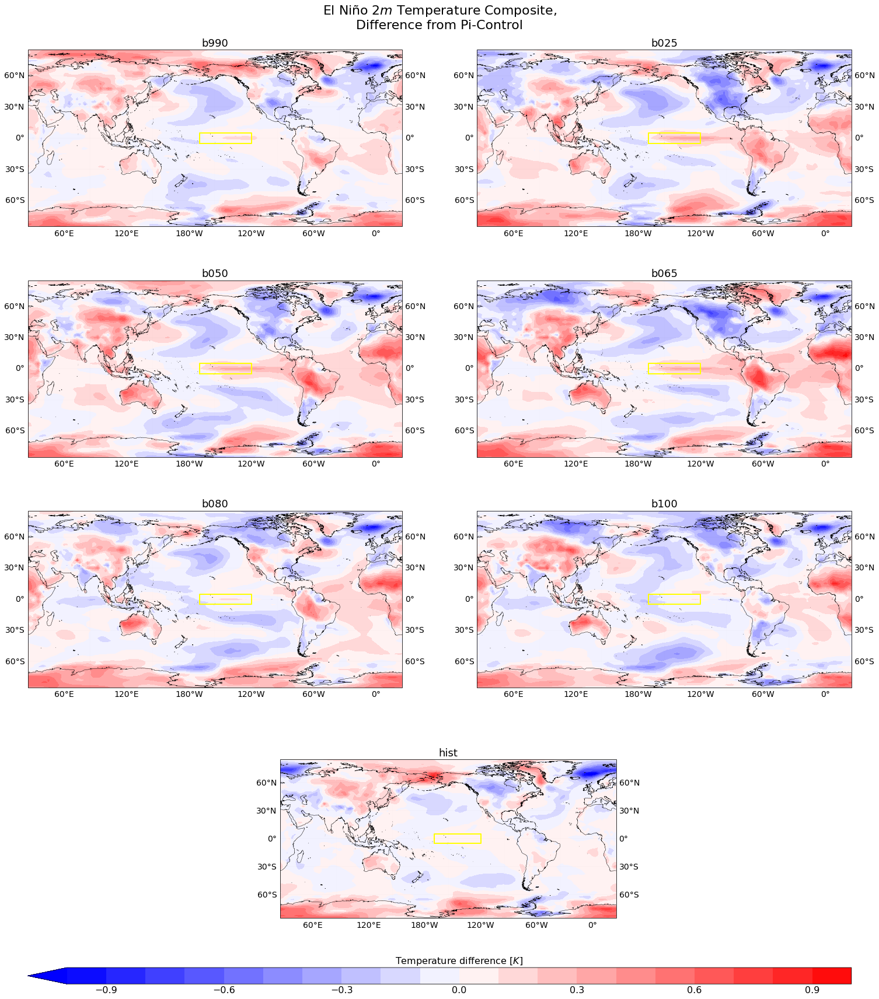

In [39]:
################################################################################################
########################## T2m composite maps for Ninõ 3.4 Index ###############################
################################# Discrepance from pi-control ##################################
########################################### Nino ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-1, 1, 21)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if i >= 6:
        i-=1
   if datasetN not in ['pi-control','obs']:
         discrepance = composite_dict['nino']['tas'][datasetN] - composite_dict['nino']['tas']['pi-control']
         row = i // 2
         col = i % 2
         # Adds coastlines to the current axes
         res = '50m'
         axs[row, col].coastlines(resolution=res, linewidths=0.5)
         # Turn on continent shading
         axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
         #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
         #ax.set_global()
         # Hide white longitude line
         cyclic = True
         lon_Of = lonO.copy()
         discrepance, lon_Of = cutil.add_cyclic_point(discrepance, coord = lon_Of)
         # Contourf-plot data
         scalar = axs[row, col].contourf(lon_Of, latO, discrepance, cmap='bwr', transform=proj0,
                              levels=levels, extend='min')
         #scalar.set_clim(-6,6)
         # Set a title for the axes.
         axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
         # Ninō 3.4 Box
         x=[lon_east, lon_west, lon_west, lon_east, lon_east]
         y=[lat_south, lat_south, lat_north, lat_north, lat_south]
         axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
         #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
         # Set axis features
         gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
         gl.left_labels =True
         gl.bottom_labels = False
         gl.top_labels = False
         gl.right_labels = True
         gl.xlines = True
         gl.xformatter = LONGITUDE_FORMATTER
         gl.yformatter = LATITUDE_FORMATTER
         gl.xlabel_style = {'size': 14, 'color': 'black'}
         gl.ylabel_style = {'size': 14, 'color': 'black'}
         # Set axis features:
            # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
         gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
         gl.left_labels = False
         gl.bottom_labels =True
         gl.top_labels = False
         gl.right_labels = False
         gl.xlines = False
         gl.xformatter = LONGITUDE_FORMATTER
         gl.yformatter = LATITUDE_FORMATTER
         gl.xlabel_style = {'size': 14, 'color': 'black'}
         gl.ylabel_style = {'size': 14, 'color': 'black'}
axs[3, 0].set_position([0.31, 0.01, 0.4, 0.2]) # [left, bottom, width, height]
fig.delaxes(axs.flatten()[i]) # Cancello il subplot vuoto
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('Temperature difference ' r'$[K]$', fontsize=16)
plt.suptitle('El Niño 'r'$2m$' ' Temperature Composite,\nDifference from Pi-Control', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_T2m-Nino-Discrep.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_T2m-Nino-Discrep.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()

In [10]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max T2m Composite Nina")
            print(np.nanmin(composite_dict['nina']['tas'][datasetN]), np.nanmax(composite_dict['nina']['tas'][datasetN]))

b990
min e max T2m Composite Nina
-1.1519043 1.2248672
b025
min e max T2m Composite Nina
-1.1835649 0.8544392
b050
min e max T2m Composite Nina
-1.3484654 0.84705377
b065
min e max T2m Composite Nina
-1.4283903 1.0847425
b080
min e max T2m Composite Nina
-1.1556857 0.6198281
b100
min e max T2m Composite Nina
-1.279514 0.65656424
pi-control
min e max T2m Composite Nina
-0.9874897 0.95921755
hist
min e max T2m Composite Nina
-1.066851 0.6614195


/tmp/ipykernel_18070/890424988.py:61: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


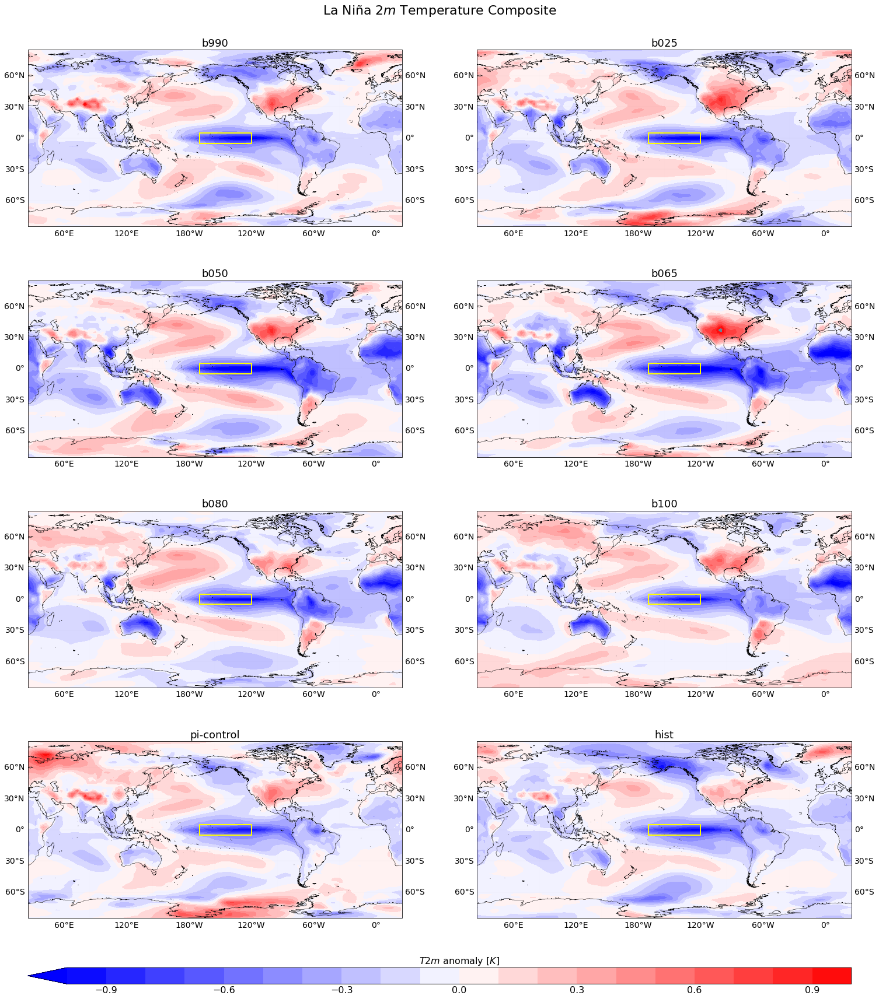

In [38]:
################################################################################################
########################## T2m composite maps for Ninõ 3.4 Index ###############################
########################################### Nina ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-1, 1, 21)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_Of = lonO.copy()
      composite_dict['nina']['tas'][datasetN], lon_Of = cutil.add_cyclic_point(composite_dict['nina']['tas'][datasetN], coord = lon_Of)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, composite_dict['nina']['tas'][datasetN], cmap='bwr', transform=proj0,
                           levels=levels, extend='min')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title(r'$T2m$' ' anomaly ' r'$[K]$', fontsize=16)
plt.suptitle('La Niña 'r'$2m$' ' Temperature Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_T2m-Nina.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_T2m-Nina.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [12]:
for datasetN in dataset_names:
   if datasetN not in dataset_names_excluded:
      print(datasetN)
      print("min e max Ua 200hPa")
      print(np.nanmin(variables_dict['trend']['ua200'][datasetN]), np.nanmax(variables_dict['trend']['ua200'][datasetN]))
      print("min e max Ua 850hPa")
      print(np.nanmin(variables_dict['trend']['ua850'][datasetN]), np.nanmax(variables_dict['trend']['ua850'][datasetN]))

b990
min e max Ua 200hPa
-3.35945764428522 4.507354349583552
min e max Ua 850hPa
-1.8754989729828322 2.5105702048998344
b025
min e max Ua 200hPa
-2.8964746570963844 4.769601268016803
min e max Ua 850hPa
-1.864841827100123 2.680924189995107
b050
min e max Ua 200hPa
-2.4780864850483275 5.100969906423929
min e max Ua 850hPa
-1.653710639848656 2.669967837084834
b065
min e max Ua 200hPa
-2.7638202660691435 4.379598256943509
min e max Ua 850hPa
-1.4625494130229106 2.6011263247375482
b080
min e max Ua 200hPa
-2.9053106979317813 4.45868734151053
min e max Ua 850hPa
-1.1968926880839423 2.825151648638687
b100
min e max Ua 200hPa
-3.519914421822877 5.036380416808238
min e max Ua 850hPa
-1.4539095866211242 3.2625659858370777
pi-control
min e max Ua 200hPa
-3.5706401399735133 4.987728872242839
min e max Ua 850hPa
-2.011488257394755 2.2287926520289862
hist
min e max Ua 200hPa
-3.451749507428926 4.585651692177799
min e max Ua 850hPa
-1.8064714621584745 2.3333584970027683


/tmp/ipykernel_2919/2146301332.py:83: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


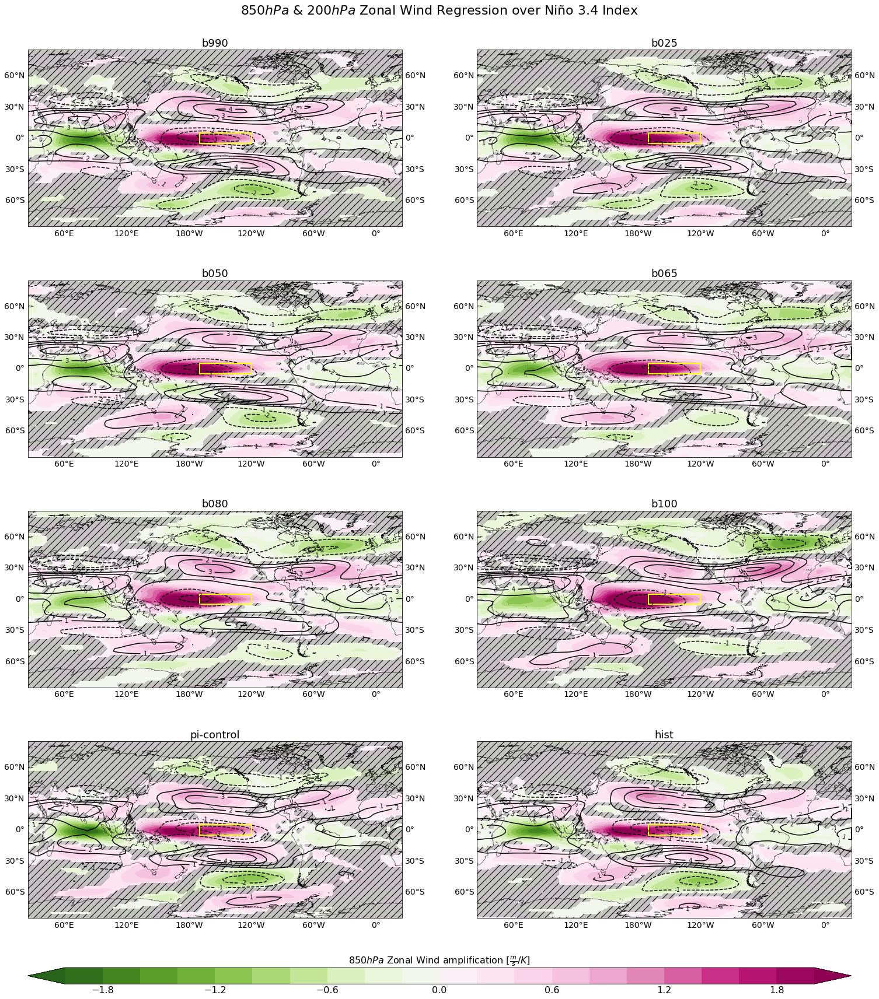

In [4]:
################################################################################################
################# U850 + U200 & U850 p value Regression over Ninõ 3.4 Index ####################
################################################################################################

plt.style.use('_mpl-gallery')

fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))

# levels of plot
levelsf=np.linspace(-2, 2, 21)
levelsf=np.round(levelsf, 2)
levels=np.arange(-5, 5, 1)
levels = [lv for lv in levels if lv!=0 ] # Rimuovo il livello 0 (altro modo per farlo: levels = np.delete(levels, index))
#levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_O = lonO.copy() # contour()
      lon_Of = lonO.copy() # first contourf()
      lon_Off = lonO.copy() # second contourf()
      variables_dict['trend']['ua850'][datasetN], lon_Of = cutil.add_cyclic_point(variables_dict['trend']['ua850'][datasetN], coord = lon_Of)
      variables_dict['trend']['ua200'][datasetN], lon_O = cutil.add_cyclic_point(variables_dict['trend']['ua200'][datasetN], coord = lon_O)
      variables_dict['pval']['ua850'][datasetN], lon_Off = cutil.add_cyclic_point(variables_dict['pval']['ua850'][datasetN], coord = lon_Off)
      # Contourf-plot data
      scalarf = axs[row, col].contourf(lon_Of, latO, variables_dict['trend']['ua850'][datasetN], cmap='PiYG_r', transform=proj0,
                           levels=levelsf, extend='both')
      # Contour-plot data
      scalar = axs[row, col].contour(lon_O, latO, variables_dict['trend']['ua200'][datasetN], colors = 'k', transform=proj0, levels=levels) #color = 'black', extend='max'
      axs[row, col].clabel(scalar, fmt='%1.0f')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      #p-value/significativity shading
      density=2
      scalarH = axs[row, col].contourf(lon_Off, latO, variables_dict['pval']['ua850'][datasetN] > 0.05, transform=proj0, colors='none',
                  levels=[0.5,1.5], hatches=[density*'/'], alpha=0.2) #ALPHA setta la trasparenza
      # Create a legend for the hatches contour set
      #artists, labels = scalarH.legend_elements(str_format='{:2.1f}'.format)
      #labels = ['p-value > 0.05']
      #legend = ax.legend(artists, labels, handleheight=2, framealpha=1, loc = 'upper left', frameon=True)
      #legend.set_zorder(100) # Posiziona la legenda in primo piano
      #legend.set_in_layout(False)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title(r'$850hPa$'' Zonal Wind amplification ' r'$[\frac{m}{s}/K]$', fontsize=16)
plt.suptitle(r'$850hPa$'' & 'r'$200hPa$'' Zonal Wind Regression over Niño 3.4 Index', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_Ua-NinoIndex.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_Ua-NinoIndex.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()

In [18]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max Wind Composite Nino + Nina")
            print("850hPa")
            print(np.nanmin(composite_dict['nino']['ua850'][datasetN]+composite_dict['nina']['ua850'][datasetN]), np.nanmax(composite_dict['nino']['ua850'][datasetN]+composite_dict['nina']['ua850'][datasetN]))
            print("200hPa")
            print(np.nanmin(composite_dict['nino']['ua200'][datasetN]+composite_dict['nina']['ua200'][datasetN]), np.nanmax(composite_dict['nino']['ua200'][datasetN]+composite_dict['nina']['ua200'][datasetN]))

b990
min e max Wind Composite Nino + Nina
850hPa
-0.5662031 0.694346
200hPa
-1.1807617 1.2936416
b025
min e max Wind Composite Nino + Nina
850hPa
-0.68559796 1.25353
200hPa
-1.134077 1.861048
b050
min e max Wind Composite Nino + Nina
850hPa
-0.784993 0.64068794
200hPa
-1.5629249 0.99779105
b065
min e max Wind Composite Nino + Nina
850hPa
-0.85148704 0.5005257
200hPa
-1.7429761 1.0755737
b080
min e max Wind Composite Nino + Nina
850hPa
-0.5649276 0.35574728
200hPa
-0.8493978 0.76873875
b100
min e max Wind Composite Nino + Nina
850hPa
-0.46530902 0.57896614
200hPa
-1.0097858 1.2589508
pi-control
min e max Wind Composite Nino + Nina
850hPa
-0.53230715 0.6107761
200hPa
-1.154614 1.7639184
hist
min e max Wind Composite Nino + Nina
850hPa
-0.5518334 0.7223631
200hPa
-0.8736819 1.0294106


/tmp/ipykernel_2919/3436956904.py:69: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


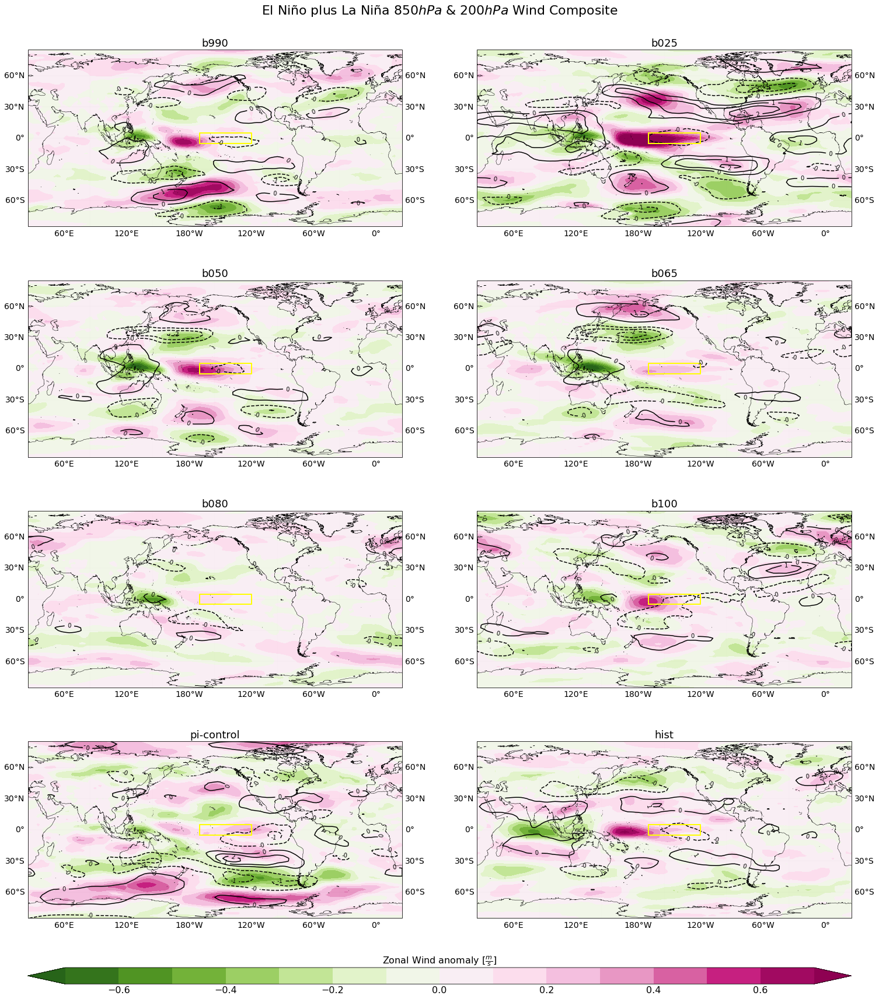

In [5]:
################################################################################################
########################## Wind composite maps for Ninõ 3.4 Index ##############################
######################################### Nino + Nina ##########################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levelsf=np.linspace(-0.7, 0.7, 15)
levelsf=np.round(levelsf, 2)
levels=[-1.5, -1, -0.5, 0.5, 1, 1.5]

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      sumf = composite_dict['nino']['ua850'][datasetN]+composite_dict['nina']['ua850'][datasetN]
      sum = composite_dict['nino']['ua200'][datasetN]+composite_dict['nina']['ua200'][datasetN]
      # Hide white longitude line
      cyclic = True
      lon_O = lonO.copy() # contour()
      lon_Of = lonO.copy() # first contourf()
      sum, lon_O = cutil.add_cyclic_point(sum, coord = lon_O)
      sumf, lon_Of = cutil.add_cyclic_point(sumf, coord = lon_Of)
      # Contourf-plot data
      scalar = axs[row, col].contour(lon_O, latO, sum, colors = 'k', transform=proj0,
                           levels=levels)
      axs[row, col].clabel(scalar, fmt='%1.0f')
      scalarf = axs[row, col].contourf(lon_Of, latO, sumf, cmap='PiYG_r', transform=proj0,
                           levels=levelsf, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('Zonal Wind anomaly ' r'$[\frac{m}{s}]$', fontsize=16)
plt.suptitle('El Niño plus La Niña 'r'$850hPa$'' & 'r'$200hPa$'' Wind Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Wind-NinoNina.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Wind-NinoNina.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [42]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max Wind Composite Nino")
            print("850hPa")
            print(np.nanmin(composite_dict['nino']['ua850'][datasetN]), np.nanmax(composite_dict['nino']['ua850'][datasetN]))
            print("200hPa")
            print(np.nanmin(composite_dict['nino']['ua200'][datasetN]), np.nanmax(composite_dict['nino']['ua200'][datasetN]))

b990
min e max Wind Composite Nino
850hPa
-1.8660402 2.7524936
200hPa
-3.5308151 5.0034738
b025
min e max Wind Composite Nino
850hPa
-2.376243 3.9086456
200hPa
-3.9276469 6.5700917
b050
min e max Wind Composite Nino
850hPa
-2.1651392 3.9154408
200hPa
-3.7643094 7.219978
b065
min e max Wind Composite Nino
850hPa
-1.8599863 3.676686
200hPa
-3.7373223 5.899056
b080
min e max Wind Composite Nino
850hPa
-1.3146317 3.2314594
200hPa
-3.1432724 4.9310417
b100
min e max Wind Composite Nino
850hPa
-1.5492157 3.3817961
200hPa
-3.3483317 4.6211925
pi-control
min e max Wind Composite Nino
850hPa
-1.8832235 2.0983007
200hPa
-3.2542856 5.4287915
hist
min e max Wind Composite Nino
850hPa
-1.985668 2.5033529
200hPa
-3.545404 4.936068


/tmp/ipykernel_2919/2848277633.py:68: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


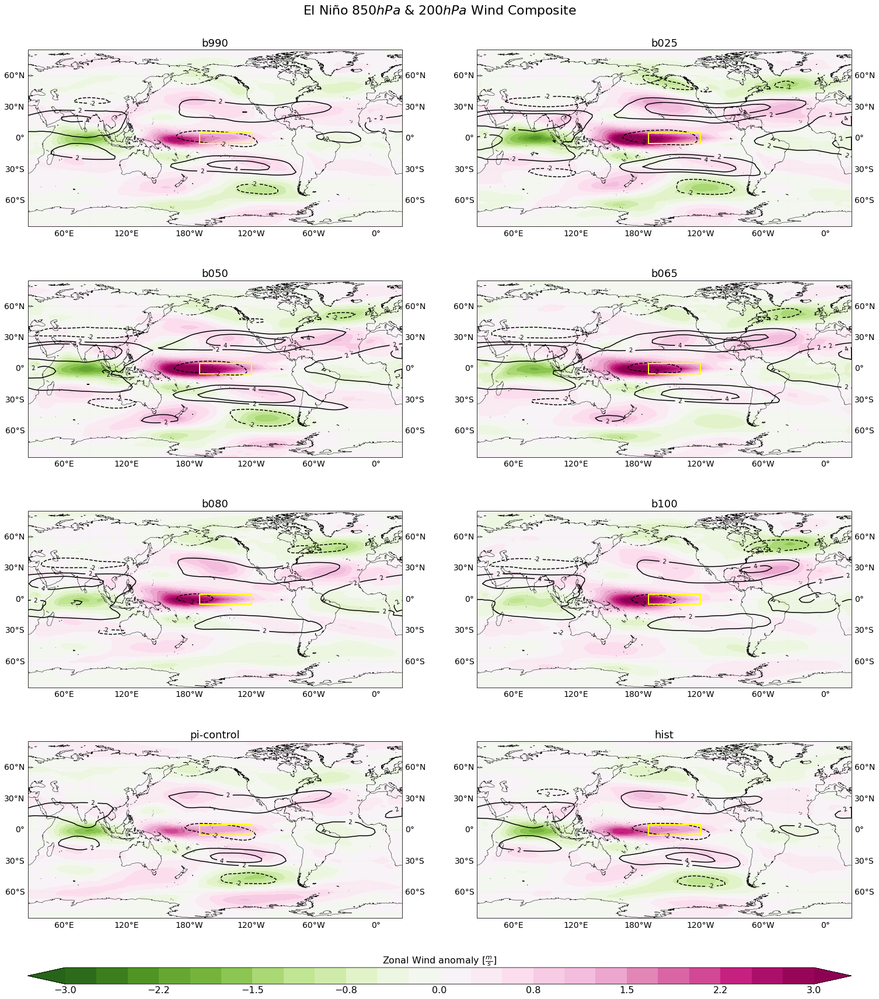

In [6]:
################################################################################################
########################## Wind composite maps for Ninõ 3.4 Index ##############################
############################################ Nino ##############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levelsf=np.linspace(-3, 3, 25)
levelsf=np.round(levelsf, 1)
levels=np.arange(-6, 6, 2)
levels = [lv for lv in levels if lv!=0 ] # Rimuovo il livello

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_O = lonO.copy() # contour()
      lon_Of = lonO.copy() # first contourf()
      composite_dict['nino']['ua200'][datasetN], lon_O = cutil.add_cyclic_point(composite_dict['nino']['ua200'][datasetN], coord = lon_O)
      composite_dict['nino']['ua850'][datasetN], lon_Of = cutil.add_cyclic_point(composite_dict['nino']['ua850'][datasetN], coord = lon_Of)
      # Contourf-plot data
      scalar = axs[row, col].contour(lon_O, latO, composite_dict['nino']['ua200'][datasetN], colors = 'k', transform=proj0,
                           levels=levels)
      axs[row, col].clabel(scalar, fmt='%1.0f')
      scalarf = axs[row, col].contourf(lon_Of, latO, composite_dict['nino']['ua850'][datasetN], cmap='PiYG_r', transform=proj0,
                           levels=levelsf, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('Zonal Wind anomaly ' r'$[\frac{m}{s}]$', fontsize=16)
plt.suptitle('El Niño 'r'$850hPa$'' & 'r'$200hPa$'' Wind Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Wind-Nino.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Wind-Nino.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [57]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max Wind Composite Nino: Dataset - Pi-control")
            print("850hPa")
            print(np.nanmin(composite_dict['nino']['ua850'][datasetN]-composite_dict['nino']['ua850']['pi-control']), np.nanmax(composite_dict['nino']['ua850'][datasetN]-composite_dict['nino']['ua850']['pi-control']))
            print("200hPa")
            print(np.nanmin(composite_dict['nino']['ua200'][datasetN]-composite_dict['nino']['ua200']['pi-control']), np.nanmax(composite_dict['nino']['ua200'][datasetN]-composite_dict['nino']['ua200']['pi-control']))

b990
min e max Wind Composite Nino: Dataset - Pi-control
850hPa
-1.0808796 0.76852167
200hPa
-1.4284191 1.4933895
b025
min e max Wind Composite Nino: Dataset - Pi-control
850hPa
-0.96833384 2.1161346
200hPa
-3.172223 3.1451492
b050
min e max Wind Composite Nino: Dataset - Pi-control
850hPa
-1.0022298 2.257426
200hPa
-3.47897 3.4290526
b065
min e max Wind Composite Nino: Dataset - Pi-control
850hPa
-1.1461393 2.09198
200hPa
-3.2166708 3.3945696
b080
min e max Wind Composite Nino: Dataset - Pi-control
850hPa
-1.1957185 1.549741
200hPa
-3.238918 2.777541
b100
min e max Wind Composite Nino: Dataset - Pi-control
850hPa
-1.0436474 1.7582643
200hPa
-2.919582 2.6850867
pi-control
min e max Wind Composite Nino: Dataset - Pi-control
850hPa
0.0 0.0
200hPa
0.0 0.0
hist
min e max Wind Composite Nino: Dataset - Pi-control
850hPa
-1.0028543 0.47801363
200hPa
-1.701915 1.9086307


/tmp/ipykernel_2919/3772442531.py:76: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


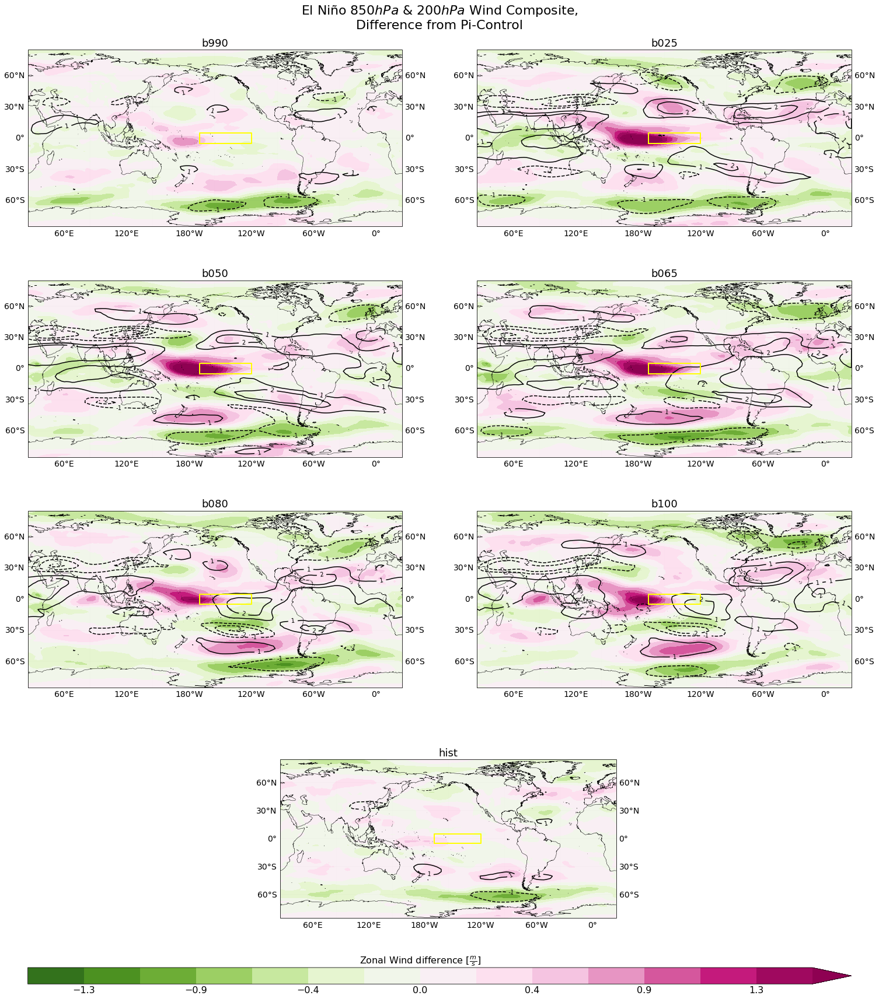

In [9]:
################################################################################################
########################## SST composite maps for Ninõ 3.4 Index ###############################
################################# Discrepance from pi-control ##################################
########################################### Nino ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levelsf=np.linspace(-1.5, 1.5, 15)
levelsf=np.round(levelsf, 1)
levels=np.arange(-3, 3, 1)
levels = [lv for lv in levels if lv!=0 ] # Rimuovo il livello

for i, datasetN in enumerate(dataset_names):
   if i >= 6:
        i-=1
   if datasetN not in ['pi-control','obs']:
         discrepance850 = composite_dict['nino']['ua850'][datasetN]-composite_dict['nino']['ua850']['pi-control']
         discrepance200 = composite_dict['nino']['ua200'][datasetN]-composite_dict['nino']['ua200']['pi-control']
         row = i // 2
         col = i % 2
         # Adds coastlines to the current axes
         res = '50m'
         axs[row, col].coastlines(resolution=res, linewidths=0.5)
         # Turn on continent shading
         axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
         #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
         #ax.set_global()
         # Hide white longitude line
         cyclic = True
         lon_O = lonO.copy() # contour()
         lon_Of = lonO.copy() # first contourf()
         discrepance200, lon_O = cutil.add_cyclic_point(discrepance200, coord = lon_O)
         discrepance850, lon_Of = cutil.add_cyclic_point(discrepance850, coord = lon_Of)
         # Contourf-plot data
         scalar = axs[row, col].contour(lon_O, latO, discrepance200, colors='k', transform=proj0,
                             levels=levels)
         # Labels in the contour line
         axs[row, col].clabel(scalar, fmt='%1.0f')
         scalarf = axs[row, col].contourf(lon_Of, latO, discrepance850, cmap='PiYG_r', transform=proj0,
                           levels=levelsf, extend='max')
         #scalar.set_clim(-6,6)
         # Set a title for the axes.
         axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
         # Ninō 3.4 Box
         x=[lon_east, lon_west, lon_west, lon_east, lon_east]
         y=[lat_south, lat_south, lat_north, lat_north, lat_south]
         axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
         #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
         # Set axis features
         gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
         gl.left_labels =True
         gl.bottom_labels = False
         gl.top_labels = False
         gl.right_labels = True
         gl.xlines = True
         gl.xformatter = LONGITUDE_FORMATTER
         gl.yformatter = LATITUDE_FORMATTER
         gl.xlabel_style = {'size': 14, 'color': 'black'}
         gl.ylabel_style = {'size': 14, 'color': 'black'}
         # Set axis features:
            # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
         gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
         gl.left_labels = False
         gl.bottom_labels =True
         gl.top_labels = False
         gl.right_labels = False
         gl.xlines = False
         gl.xformatter = LONGITUDE_FORMATTER
         gl.yformatter = LATITUDE_FORMATTER
         gl.xlabel_style = {'size': 14, 'color': 'black'}
         gl.ylabel_style = {'size': 14, 'color': 'black'}
axs[3, 0].set_position([0.31, 0.01, 0.4, 0.2]) # [left, bottom, width, height]
fig.delaxes(axs.flatten()[i]) # Cancello il subplot vuoto
# Add color bar
cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('Zonal Wind difference ' r'$[\frac{m}{s}]$', fontsize=16)
plt.suptitle('El Niño 'r'$850hPa$'' & 'r'$200hPa$'' Wind Composite,\nDifference from Pi-Control', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Wind-Nino-Discrep.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Wind-Nino-Discrep.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [51]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max Wind Composite Nino")
            print("850hPa")
            print(np.nanmin(composite_dict['nina']['ua850'][datasetN]), np.nanmax(composite_dict['nina']['ua850'][datasetN]))
            print("200hPa")
            print(np.nanmin(composite_dict['nina']['ua200'][datasetN]), np.nanmax(composite_dict['nina']['ua200'][datasetN]))

b990
min e max Wind Composite Nino
850hPa
-2.2179127 1.9497061
200hPa
-4.33793 2.897514
b025
min e max Wind Composite Nino
850hPa
-2.858412 2.232125
200hPa
-5.265729 3.065189
b050
min e max Wind Composite Nino
850hPa
-3.4234824 2.3650837
200hPa
-6.521534 3.2916708
b065
min e max Wind Composite Nino
850hPa
-3.5105848 2.1557431
200hPa
-6.148357 3.8238726
b080
min e max Wind Composite Nino
850hPa
-3.1985927 1.4758066
200hPa
-5.2641172 3.3405187
b100
min e max Wind Composite Nino
850hPa
-2.9962752 1.318422
200hPa
-4.940659 3.1425927
pi-control
min e max Wind Composite Nino
850hPa
-1.9368391 1.7791196
200hPa
-3.86477 2.9486883
hist
min e max Wind Composite Nino
850hPa
-1.8044543 1.4763757
200hPa
-4.0015664 2.8782802


/tmp/ipykernel_2919/293252110.py:68: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


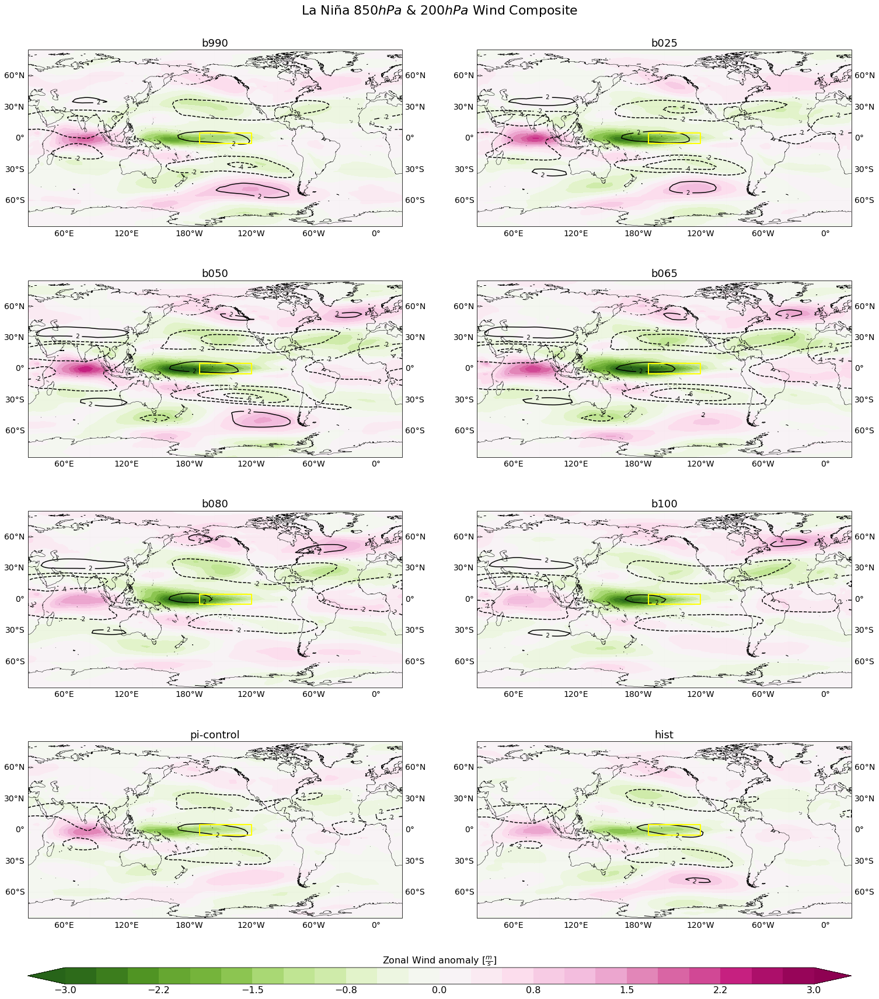

In [10]:
################################################################################################
########################## Wind composite maps for Ninõ 3.4 Index ##############################
############################################ Nina ##############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levelsf=np.linspace(-3, 3, 25)
levelsf=np.round(levelsf, 1)
levels=np.arange(-6, 6, 2)
levels = [lv for lv in levels if lv!=0 ] # Rimuovo il livello

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_O = lonO.copy() # contour()
      lon_Of = lonO.copy() # first contourf()
      composite_dict['nina']['ua200'][datasetN], lon_O = cutil.add_cyclic_point(composite_dict['nina']['ua200'][datasetN], coord = lon_O)
      composite_dict['nina']['ua850'][datasetN], lon_Of = cutil.add_cyclic_point(composite_dict['nina']['ua850'][datasetN], coord = lon_Of)
      # Contourf-plot data
      scalar = axs[row, col].contour(lon_O, latO, composite_dict['nina']['ua200'][datasetN], colors = 'k', transform=proj0,
                           levels=levels)
      axs[row, col].clabel(scalar, fmt='%1.0f')
      scalarf = axs[row, col].contourf(lon_Of, latO, composite_dict['nina']['ua850'][datasetN], cmap='PiYG_r', transform=proj0,
                           levels=levelsf, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalarf, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('Zonal Wind anomaly ' r'$[\frac{m}{s}]$', fontsize=16)
plt.suptitle('La Niña 'r'$850hPa$'' & 'r'$200hPa$'' Wind Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Wind-Nina.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Wind-Nina.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [67]:
for datasetN in dataset_names:
   if datasetN not in dataset_names_excluded:
      print(datasetN)
      print("min e max Prec")
      print(np.nanmin(variables_dict['trend']['pr'][datasetN]*86400), np.nanmax(variables_dict['trend']['pr'][datasetN]*86400))

b990
min e max Prec
-2.2086588111235654 3.2764208773819687
b025
min e max Prec
-2.2548350018326038 3.0546864164306755
b050
min e max Prec
-2.3805920263644134 2.836558424185644
b065
min e max Prec
-2.1351229162011465 2.6249541534978813
b080
min e max Prec
-2.7158482396991555 3.4461540780665585
b100
min e max Prec
-3.7468552781073012 4.354561683464931
pi-control
min e max Prec
-2.356630861425009 3.1929959319427765
hist
min e max Prec
-1.8544713856267891 3.1711791325906296


/tmp/ipykernel_18070/3426503424.py:74: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


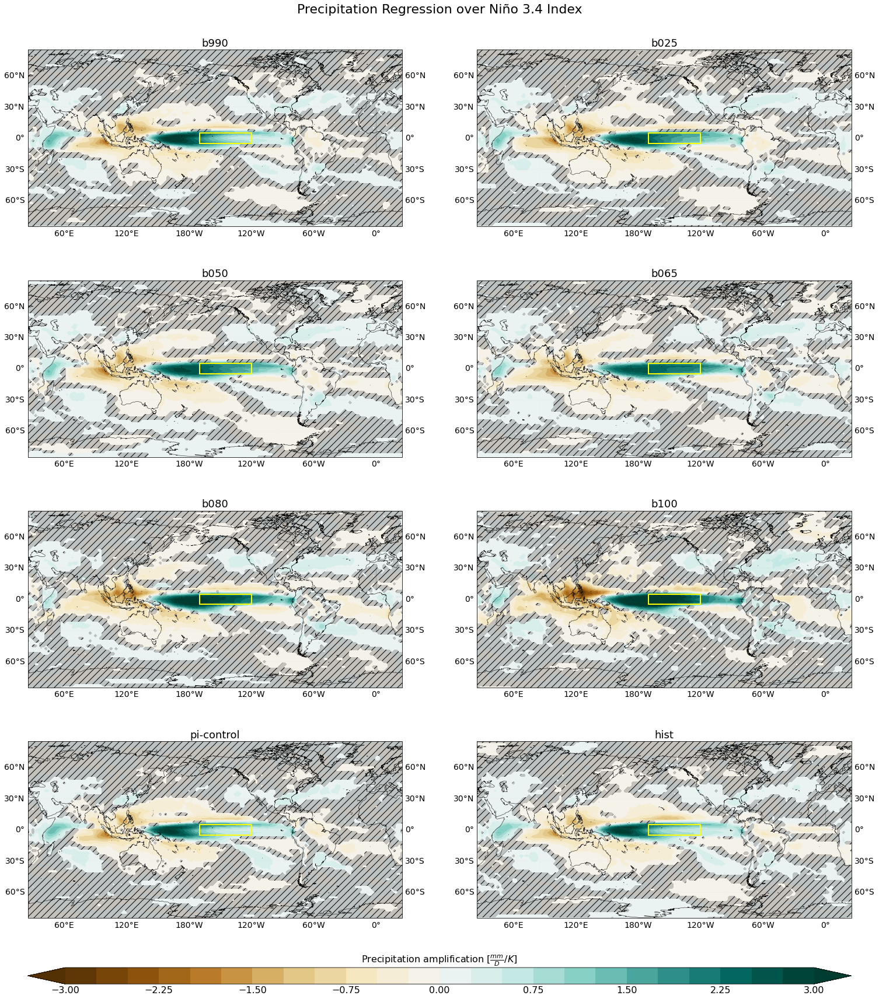

In [63]:
################################################################################################
##################### Prec & p value regression over Ninõ 3.4 Index ############################
################################################################################################
plt.style.use('_mpl-gallery')

fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))

# levels of plot
levels=np.linspace(-3, 3, 25)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_Of = lonO.copy() # first contourf()
      lon_Off = lonO.copy() # second contourf()
      variables_dict['trend']['pr'][datasetN], lon_Of = cutil.add_cyclic_point(variables_dict['trend']['pr'][datasetN], coord = lon_Of)
      variables_dict['pval']['pr'][datasetN], lon_Off = cutil.add_cyclic_point(variables_dict['pval']['pr'][datasetN], coord = lon_Off)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, variables_dict['trend']['pr'][datasetN]*86400, cmap='BrBG', transform=proj0,
                           levels=levels, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      #p-value/significativity shading
      density=2
      scalarH = axs[row, col].contourf(lon_Off, latO, variables_dict['pval']['pr'][datasetN] > 0.05, transform=proj0, colors='none',
                  levels=[0.5,1.5], hatches=[density*'/'], alpha=0.2) #ALPHA setta la trasparenza
      # Create a legend for the hatches contour set
      #artists, labels = scalarH.legend_elements(str_format='{:2.1f}'.format)
      #labels = ['p-value > 0.05']
      #legend = ax.legend(artists, labels, handleheight=2, framealpha=1, loc = 'upper left', frameon=True)
      #legend.set_zorder(100) # Posiziona la legenda in primo piano
      #legend.set_in_layout(False)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('Precipitation amplification ' r'$[\frac{mm}{D}/K]$', fontsize=16)
# Cancello il subplot vuoto
#fig.delaxes(axs.flatten()[i+1])
plt.suptitle('Precipitation Regression over Niño 3.4 Index', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_Prec-NinoIndex.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_Prec-NinoIndex.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()

In [71]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max Prec Composite Nino + Nina")
            print(np.nanmin((composite_dict['nino']['pr'][datasetN]+composite_dict['nina']['pr'][datasetN])*86400), np.nanmax((composite_dict['nino']['pr'][datasetN]+composite_dict['nina']['pr'][datasetN]))*86400)

b990
min e max Prec Composite Nino + Nina
-1.199683648883365 1.0670069488696754
b025
min e max Prec Composite Nino + Nina
-1.6927371849305928 1.838169596157968
b050
min e max Prec Composite Nino + Nina
-1.7193818930536509 1.2645374983549118
b065
min e max Prec Composite Nino + Nina
-1.750843576155603 0.9841574938036501
b080
min e max Prec Composite Nino + Nina
-1.4286720310337842 0.7720047142356634
b100
min e max Prec Composite Nino + Nina
-1.8892171152401716 1.170047465711832
pi-control
min e max Prec Composite Nino + Nina
-1.0083169414428994 0.8022625464946032
hist
min e max Prec Composite Nino + Nina
-0.8219989424105734 1.0850846709217876


/tmp/ipykernel_2919/404376482.py:62: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


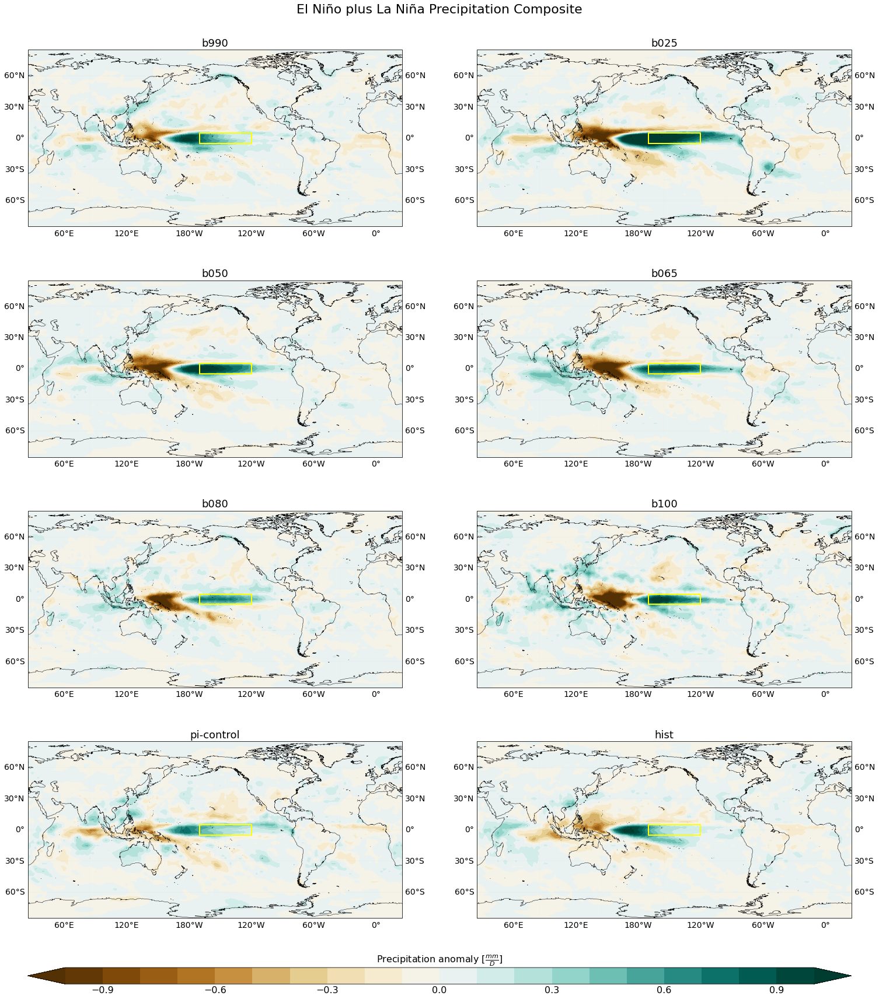

In [11]:
################################################################################################
########################## Prec composite maps for Ninõ 3.4 Index ###############################
######################################### Nino + Nina ##########################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-1, 1, 21)
levels=np.round(levels, 1)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      sum = (composite_dict['nino']['pr'][datasetN]+composite_dict['nina']['pr'][datasetN])*86400
      cyclic = True
      lon_Of = lonO.copy()
      sum, lon_Of = cutil.add_cyclic_point(sum, coord = lon_Of)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, sum, cmap='BrBG', transform=proj0,
                           levels=levels, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('Precipitation anomaly ' r'$[\frac{mm}{D}]$', fontsize=16)
plt.suptitle('El Niño plus La Niña Precipitation Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Prec-NinoNina.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Prec-NinoNina.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [76]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max Prec Composite Nino")
            print(np.nanmin(composite_dict['nino']['pr'][datasetN]*86400), np.nanmax(composite_dict['nino']['pr'][datasetN]*86400))

b990
min e max Prec Composite Nino
-2.316289016744122 3.8711917237378657
b025
min e max Prec Composite Nino
-2.850476454477757 4.852620279416442
b050
min e max Prec Composite Nino
-3.2860287465155125 4.564344836398959
b065
min e max Prec Composite Nino
-2.7674616663716733 4.19679848710075
b080
min e max Prec Composite Nino
-3.2252996577881277 4.290500830393285
b100
min e max Prec Composite Nino
-3.92932043178007 4.58933369955048
pi-control
min e max Prec Composite Nino
-2.321175771066919 3.235497500281781
hist
min e max Prec Composite Nino
-2.1890675998292863 3.682319785002619


/tmp/ipykernel_18070/2934004594.py:61: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


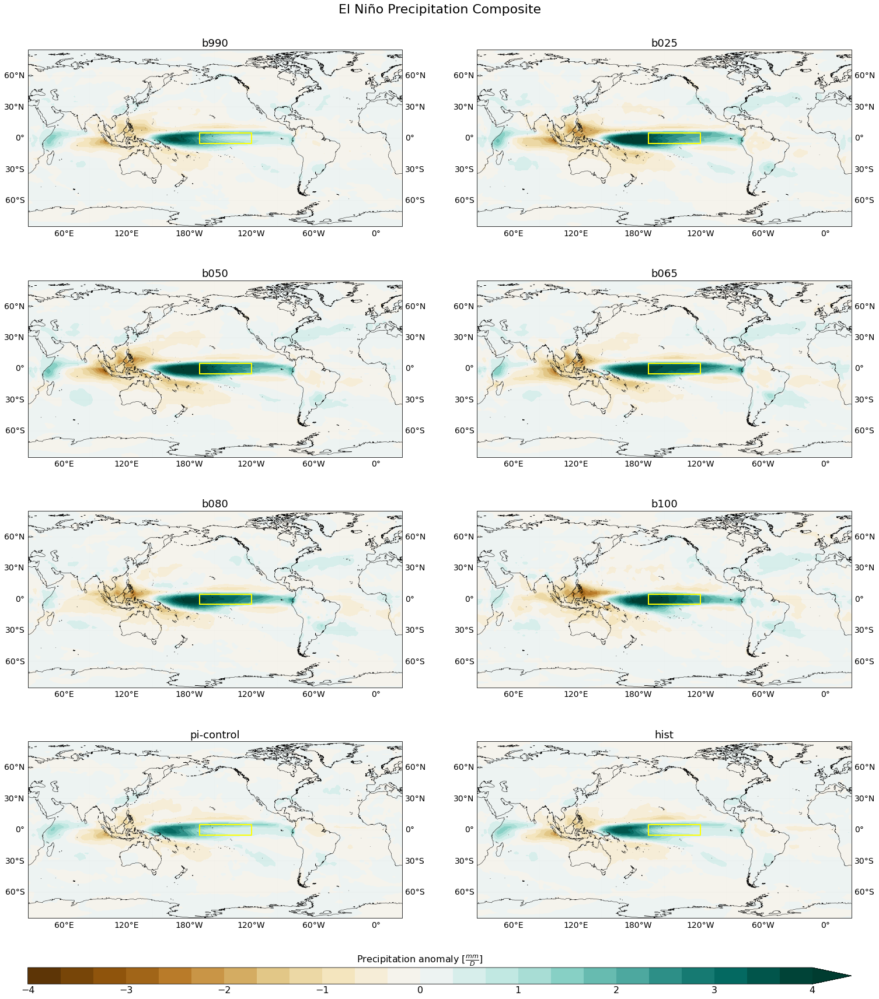

In [69]:
################################################################################################
########################## Prec composite maps for Ninõ 3.4 Index ###############################
########################################### Nino ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-4, 4, 25)
levels=np.round(levels, 1)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_Of = lonO.copy()
      composite_dict['nino']['pr'][datasetN], lon_Of = cutil.add_cyclic_point(composite_dict['nino']['pr'][datasetN], coord = lon_Of)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, composite_dict['nino']['pr'][datasetN]*86400, cmap='BrBG', transform=proj0,
                           levels=levels, extend='max')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('Precipitation anomaly ' r'$[\frac{mm}{D}]$', fontsize=16)
plt.suptitle('El Niño Precipitation Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Prec-Nino.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Prec-Nino.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [82]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max Prec Composite Nino discrepance from pi-control")
            print(np.nanmin((composite_dict['nino']['pr'][datasetN]-composite_dict['nino']['pr']['pi-control'])*86400), np.nanmax((composite_dict['nino']['pr'][datasetN]-composite_dict['nino']['pr']['pi-control'])*86400))

b990
min e max Prec Composite Nino discrepance from pi-control
-0.9280987491365522 1.1830628849565983
b025
min e max Prec Composite Nino discrepance from pi-control
-1.7227140138857067 2.8212693985551596
b050
min e max Prec Composite Nino discrepance from pi-control
-1.8227629770990461 3.0758483335375786
b065
min e max Prec Composite Nino discrepance from pi-control
-1.885603676782921 3.068482526578009
b080
min e max Prec Composite Nino discrepance from pi-control
-2.1913597884122282 2.982473513111472
b100
min e max Prec Composite Nino discrepance from pi-control
-2.7199306176044047 3.554570465348661
pi-control
min e max Prec Composite Nino discrepance from pi-control
0.0 0.0
hist
min e max Prec Composite Nino discrepance from pi-control
-0.6462771096266806 0.718700053403154


/tmp/ipykernel_18070/4222304618.py:67: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


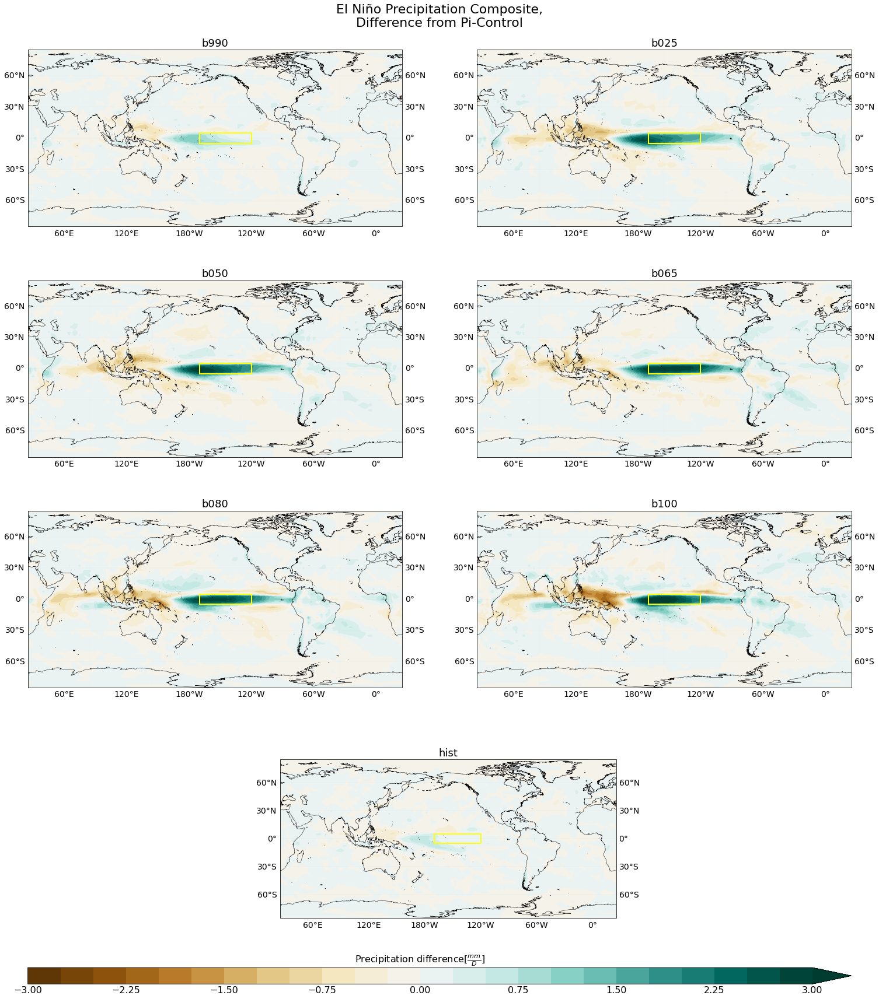

In [72]:
################################################################################################
########################## Prec composite maps for Ninõ 3.4 Index ##############################
################################# Discrepance from pi-control ##################################
########################################### Nino ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-3, 3, 25)
levels=np.round(levels, 2)

for i, datasetN in enumerate(dataset_names):
   if i >= 6:
        i-=1
   if datasetN not in ['pi-control','obs']:
         discrepance = (composite_dict['nino']['pr'][datasetN] - composite_dict['nino']['pr']['pi-control'])*86400
         row = i // 2
         col = i % 2
         # Adds coastlines to the current axes
         res = '50m'
         axs[row, col].coastlines(resolution=res, linewidths=0.5)
         # Turn on continent shading
         axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
         #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
         #ax.set_global()
         # Hide white longitude line
         cyclic = True
         lon_Of = lonO.copy()
         discrepance, lon_Of = cutil.add_cyclic_point(discrepance, coord = lon_Of)
         # Contourf-plot data
         scalar = axs[row, col].contourf(lon_Of, latO, discrepance, cmap='BrBG', transform=proj0,
                              levels=levels, extend='max')
         #scalar.set_clim(-6,6)
         # Set a title for the axes.
         axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
         # Ninō 3.4 Box
         x=[lon_east, lon_west, lon_west, lon_east, lon_east]
         y=[lat_south, lat_south, lat_north, lat_north, lat_south]
         axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
         #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
         # Set axis features
         gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
         gl.left_labels =True
         gl.bottom_labels = False
         gl.top_labels = False
         gl.right_labels = True
         gl.xlines = True
         gl.xformatter = LONGITUDE_FORMATTER
         gl.yformatter = LATITUDE_FORMATTER
         gl.xlabel_style = {'size': 14, 'color': 'black'}
         gl.ylabel_style = {'size': 14, 'color': 'black'}
         # Set axis features:
            # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
         gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
         gl.left_labels = False
         gl.bottom_labels =True
         gl.top_labels = False
         gl.right_labels = False
         gl.xlines = False
         gl.xformatter = LONGITUDE_FORMATTER
         gl.yformatter = LATITUDE_FORMATTER
         gl.xlabel_style = {'size': 14, 'color': 'black'}
         gl.ylabel_style = {'size': 14, 'color': 'black'}
axs[3, 0].set_position([0.31, 0.01, 0.4, 0.2]) # [left, bottom, width, height]
fig.delaxes(axs.flatten()[i]) # Cancello il subplot vuoto
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('Precipitation difference' r'$[\frac{mm}{D}]$', fontsize=16)
plt.suptitle('El Niño Precipitation Composite,\nDifference from Pi-Control', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Prec-Nino-Discrep.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Prec-Nino-Discrep.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [81]:
for datasetN in dataset_names:
      if datasetN not in dataset_names_excluded:
            print(datasetN)
            print("min e max Prec Composite Nina")
            print(np.nanmin(composite_dict['nina']['pr'][datasetN]*86400), np.nanmax(composite_dict['nina']['pr'][datasetN]*86400))

b990
min e max Prec Composite Nina
-3.3266538404859602 2.267101965844631
b025
min e max Prec Composite Nina
-3.6565498332493007 2.7128706453368068
b050
min e max Prec Composite Nina
-4.170641605742276 3.2722504693083465
b065
min e max Prec Composite Nina
-4.287166823633015 3.212594788055867
b080
min e max Prec Composite Nina
-4.025698907207698 3.491304803173989
b100
min e max Prec Composite Nina
-4.141115199308842 3.5933888400904834
pi-control
min e max Prec Composite Nina
-2.948026719968766 2.084635739447549
hist
min e max Prec Composite Nina
-2.868852310348302 1.5577666461467743


/tmp/ipykernel_18070/2485483226.py:61: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


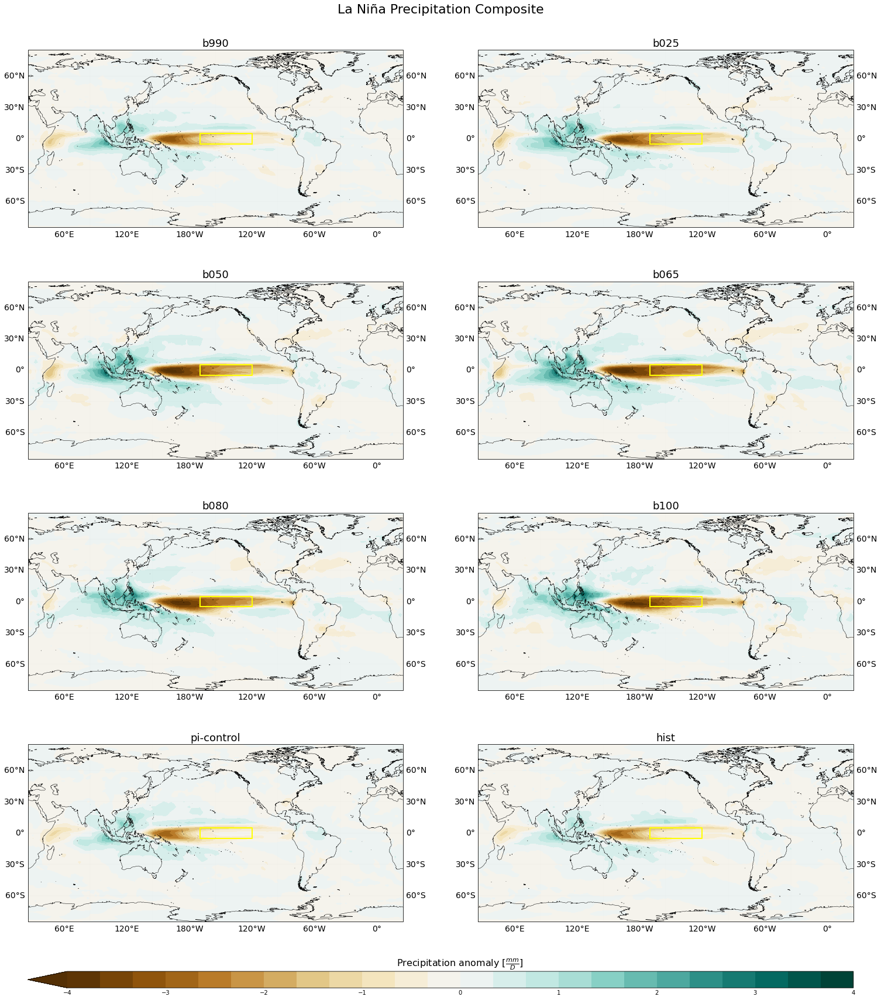

In [73]:
################################################################################################
########################## Prec composite maps for Ninõ 3.4 Index ###############################
########################################### Nina ###############################################
################################################################################################
plt.style.use('_mpl-gallery')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))
# levels of plot
levels=np.linspace(-4, 4, 25)
levels=np.round(levels, 1)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_Of = lonO.copy()
      composite_dict['nina']['pr'][datasetN], lon_Of = cutil.add_cyclic_point(composite_dict['nina']['pr'][datasetN], coord = lon_Of)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, composite_dict['nina']['pr'][datasetN]*86400, cmap='BrBG', transform=proj0,
                           levels=levels, extend='min')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.set_title('Precipitation anomaly ' r'$[\frac{mm}{D}]$', fontsize=16)
plt.suptitle('La Niña Precipitation Composite', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Prec-Nina.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images8 + 'Composite_Prec-Nina.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()   

In [87]:
for datasetN in dataset_names:
   if datasetN not in dataset_names_excluded:
      print(datasetN)
      print("min e max GeoPot 500hPa")
      print(np.nanmin(variables_dict['trend']['zg'][datasetN]), np.nanmax(variables_dict['trend']['zg'][datasetN]))

b990
min e max GeoPot 500hPa
-43.515729197185536 37.133911160776925
b025
min e max GeoPot 500hPa
-33.930472236689276 19.432504296727696
b050
min e max GeoPot 500hPa
-22.376779308149253 12.902656392074269
b065
min e max GeoPot 500hPa
-32.97060019820765 14.16131856545007
b080
min e max GeoPot 500hPa
-45.535376320283085 34.311415058464185
b100
min e max GeoPot 500hPa
-40.17285543971869 21.769331365285083
pi-control
min e max GeoPot 500hPa
-35.313827012710476 25.62536935728758
hist
min e max GeoPot 500hPa
-37.67785040714595 26.943938637878208


/tmp/ipykernel_18070/2630704099.py:77: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


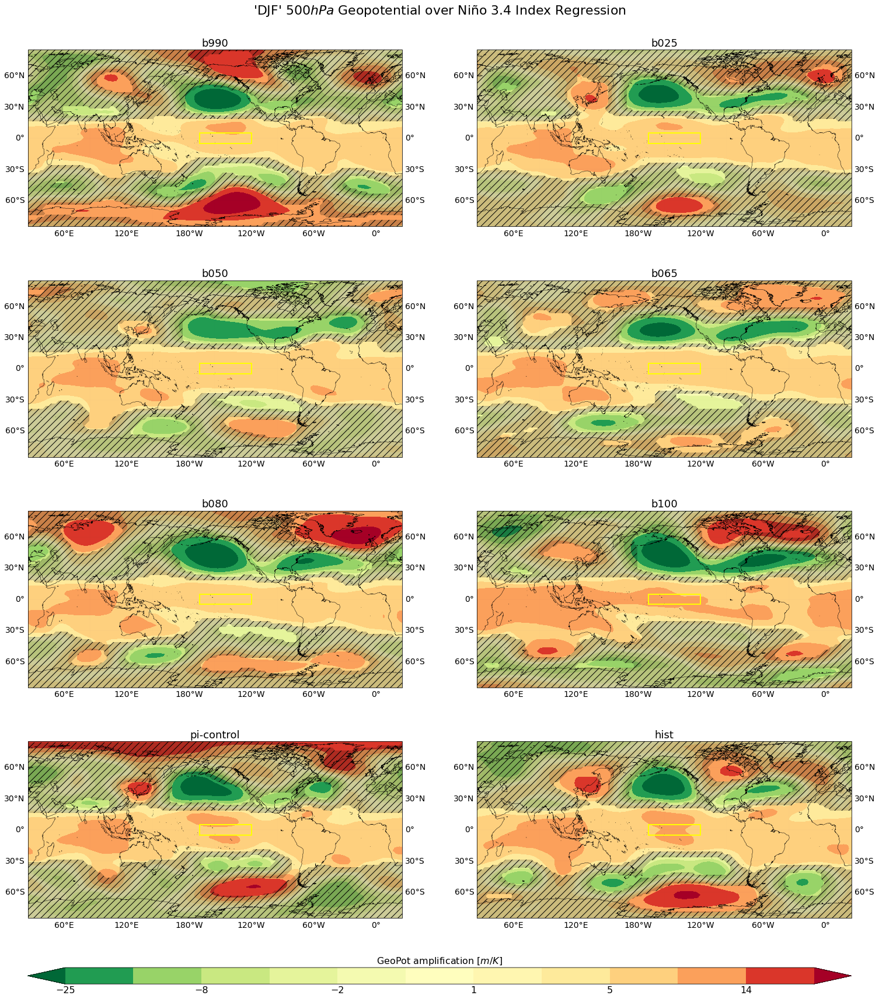

In [74]:
##################################################################################################
#################### 500hPaGeopot & p value Regression over Ninõ 3.4 Index #######################
##################################################################################################
plt.style.use('_mpl-gallery')

fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))

# levels of plot
levelsSX = np.geomspace(-25, -1, num=7, endpoint=True, dtype=int)
levelsDX = np.geomspace(1, 25, num=7, endpoint=True, dtype=int)
#levels=np.round(levels, 2)
levels = np.concatenate((levelsSX, levelsDX))
levels = np.delete(levels, [6,7])

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_Of = lonO.copy() # first contourf()
      lon_Off = lonO.copy() # second contourf()
      variables_dict['trend']['zg'][datasetN], lon_Of = cutil.add_cyclic_point(variables_dict['trend']['zg'][datasetN], coord = lon_Of)
      variables_dict['pval']['zg'][datasetN], lon_Off = cutil.add_cyclic_point(variables_dict['pval']['zg'][datasetN], coord = lon_Off)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, variables_dict['trend']['zg'][datasetN], cmap='RdYlGn_r', transform=proj0,
                           levels=levels, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      #p-value/significativity shading
      density=2
      scalarH = axs[row, col].contourf(lon_Off, latO, variables_dict['pval']['zg'][datasetN] > 0.05, transform=proj0, colors='none',
                  levels=[0.5,1.5], hatches=[density*'/'], alpha=0.2) #ALPHA setta la trasparenza
      # Create a legend for the hatches contour set
      #artists, labels = scalarH.legend_elements(str_format='{:2.1f}'.format)
      #labels = ['p-value > 0.05']
      #legend = ax.legend(artists, labels, handleheight=2, framealpha=1, loc = 'upper left', frameon=True)
      #legend.set_zorder(100) # Posiziona la legenda in primo piano
      #legend.set_in_layout(False)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('GeoPot amplification ' r'$[m/K]$', fontsize=16)
# Cancello il subplot vuoto
#fig.delaxes(axs.flatten()[i+1])
plt.suptitle('\'DJF\' 'r'$500hPa$'' Geopotential over Niño 3.4 Index Regression', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
#fig.savefig(common_Dir_home + dir_Images6 + 'Regression_Zg500-NinoIndex.pdf', bbox_inches='tight', dpi=300)
# Display the figure
plt.show()

/tmp/ipykernel_18070/3995515945.py:73: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)


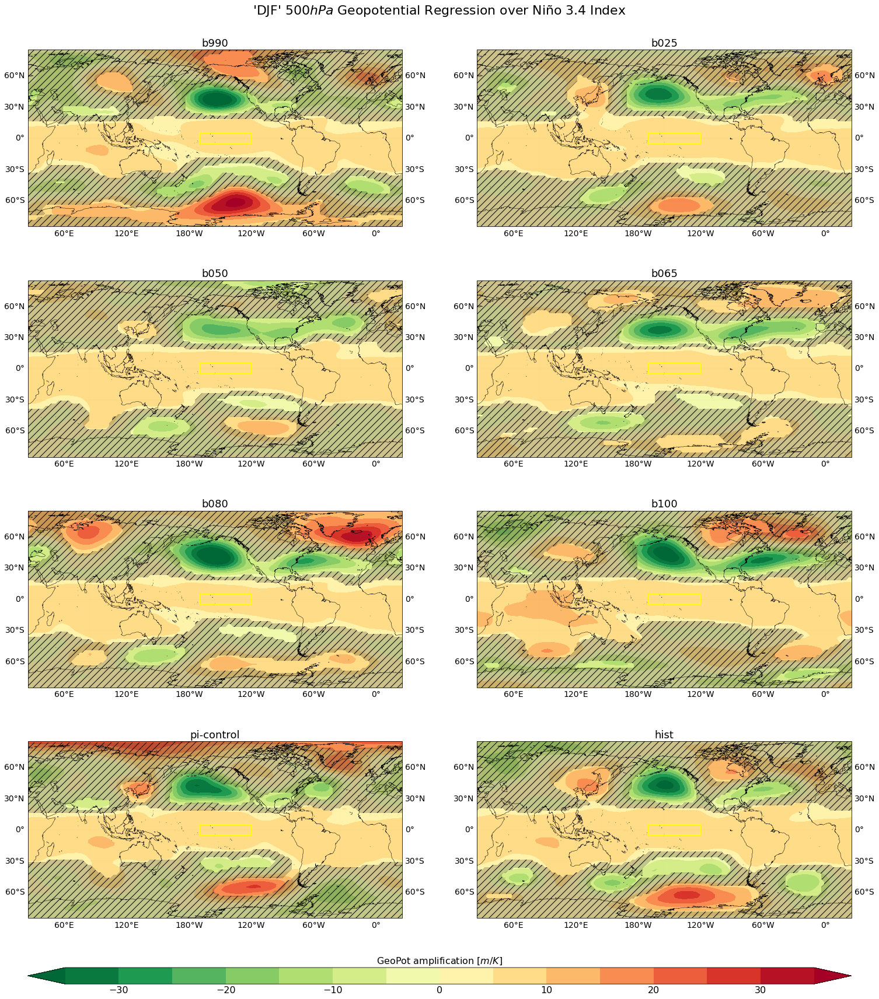

In [77]:
##################################################################################################
#################### 500hPaGeopot & p value Regression over Ninõ 3.4 Index #######################
##################################################################################################
plt.style.use('_mpl-gallery')

fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(20, 24), subplot_kw=dict(projection=proj))

# levels of plot
levels=np.arange(-35, 36, 5)

for i, datasetN in enumerate(dataset_names):
   if datasetN not in dataset_names_excluded:
      row = i // 2
      col = i % 2
      # Adds coastlines to the current axes
      res = '50m'
      axs[row, col].coastlines(resolution=res, linewidths=0.5)
      # Turn on continent shading
      axs[row, col].add_feature(cfeature.LAND.with_scale(res), facecolor='slategray')
      #ax.add_feature(cart.feature.LAND, zorder=100, facecolor='slategray', edgecolor='k') #ZORDER serve per mettere la maschera in 1° piano
      #ax.set_global()
      # Hide white longitude line
      cyclic = True
      lon_Of = lonO.copy() # first contourf()
      lon_Off = lonO.copy() # second contourf()
      variables_dict['trend']['zg'][datasetN], lon_Of = cutil.add_cyclic_point(variables_dict['trend']['zg'][datasetN], coord = lon_Of)
      variables_dict['pval']['zg'][datasetN], lon_Off = cutil.add_cyclic_point(variables_dict['pval']['zg'][datasetN], coord = lon_Off)
      # Contourf-plot data
      scalar = axs[row, col].contourf(lon_Of, latO, variables_dict['trend']['zg'][datasetN], cmap='RdYlGn_r', transform=proj0,
                           levels=levels, extend='both')
      #scalar.set_clim(-6,6)
      # Set a title for the axes.
      axs[row, col].set_title('{}'.format(datasetN), fontsize=18)
      #p-value/significativity shading
      density=2
      scalarH = axs[row, col].contourf(lon_Off, latO, variables_dict['pval']['zg'][datasetN] > 0.05, transform=proj0, colors='none',
                  levels=[0.5,1.5], hatches=[density*'/'], alpha=0.2) #ALPHA setta la trasparenza
      # Create a legend for the hatches contour set
      #artists, labels = scalarH.legend_elements(str_format='{:2.1f}'.format)
      #labels = ['p-value > 0.05']
      #legend = ax.legend(artists, labels, handleheight=2, framealpha=1, loc = 'upper left', frameon=True)
      #legend.set_zorder(100) # Posiziona la legenda in primo piano
      #legend.set_in_layout(False)
      # Ninō 3.4 Box
      x=[lon_east, lon_west, lon_west, lon_east, lon_east]
      y=[lat_south, lat_south, lat_north, lat_north, lat_south]
      axs[row, col].plot(x, y, color='yellow', linewidth=2, transform=proj0)
      #ax.text(-3, 0, 'Niño3.4 Box', style='italic', color='w', fontsize=10) # -155, 0
      # Set axis features
      gl = axs[row, col].gridlines(crs=proj, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels =True
      gl.bottom_labels = False
      gl.top_labels = False
      gl.right_labels = True
      gl.xlines = True
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
      # Set axis features:
         # 2° ripetizione in cui si cambia il 'crs' per poter disegnare le labels sulla destra del plot
      gl = axs[row, col].gridlines(crs=proj0, draw_labels=True, linewidth=0.01, color='gray', alpha=0.5, linestyle='--')
      gl.left_labels = False
      gl.bottom_labels =True
      gl.top_labels = False
      gl.right_labels = False
      gl.xlines = False
      gl.xformatter = LONGITUDE_FORMATTER
      gl.yformatter = LATITUDE_FORMATTER
      gl.xlabel_style = {'size': 14, 'color': 'black'}
      gl.ylabel_style = {'size': 14, 'color': 'black'}
# Add color bar
cbar = plt.colorbar(scalar, ax=axs, orientation='horizontal', aspect=50, fraction=0.055, pad=0.05)
cbar.ax.tick_params(labelsize=16)
cbar.ax.set_title('GeoPot amplification ' r'$[m/K]$', fontsize=16)
# Cancello il subplot vuoto
#fig.delaxes(axs.flatten()[i+1])
plt.suptitle('\'DJF\' 'r'$500hPa$'' Geopotential Regression over Niño 3.4 Index', fontsize=22, y=1.02)
#plt.tight_layout()
# Save the current figure to a file
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_Zg500-NinoIndex.pdf', bbox_inches='tight')
fig.savefig(common_Dir_home + dir_Images6 + 'Regression_Zg500-NinoIndex.jpg', bbox_inches='tight', dpi=150)
# Display the figure
plt.show()

In [ ]:
"""
NB: Non ci sono le compisit del campo zg500 'DJF', per il modo in cui esso è stato calcolato:
raggruppare n mesi di ogni anno per poi farne una media porta ad avere lo stesso dato per il
campo 'nino' e 'nina' relativi allo stesso punto nello stesso anno.
"""